In [1]:
%load_ext autoreload
%autoreload 2
%load_ext watermark
%watermark -v -n -m -p numpy,scipy,sklearn,pandas

Thu Jan 31 2019 

CPython 3.6.8
IPython 7.2.0

numpy 1.15.4
scipy 1.2.0
sklearn 0.20.2
pandas 0.24.0

compiler   : GCC 7.3.0
system     : Linux
release    : 4.20.5-arch1-1-ARCH
machine    : x86_64
processor  : 
CPU cores  : 16
interpreter: 64bit


In [28]:
# %matplotlib notebook
%matplotlib inline
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os
import nolds
import data
import mne

PROJ_ROOT = os.path.abspath(os.path.join(os.pardir))
DATA_ROOT = os.path.abspath(os.path.join(PROJ_ROOT, 'data'))
PROCESSED_ROOT = os.path.abspath(os.path.join(DATA_ROOT, 'processed'))
RAW_ROOT = os.path.abspath(os.path.join(DATA_ROOT, 'raw'))
LABELED_ROOT = os.path.abspath(os.path.join(DATA_ROOT, 'labeled'))
DURATIONS_ROOT = os.path.abspath(os.path.join(DATA_ROOT, 'durations'))
print(PROJ_ROOT)
print(DATA_ROOT)
print(PROCESSED_ROOT)
import sys
sys.path.append(os.path.join(PROJ_ROOT, 'src'))
CHANNEL_NAMES = ['FP1', 'FP2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2',
                 'F7', 'F8', 'T3', 'T4', 'T5', 'T6', 'Fz', 'Cz', 'Pz']
META_COLUMN_NAMES = ['freq', 'RESP_4W', 'RESP_FIN', 'REMISE_FIN', 'AGE', 'SEX', 'M_1',
       'M_4', 'M_F', 'délka léčby', 'lék 1', 'lék 2', 'lék 3', 'lék 4']
META_FILE_NAME = 'DEP-POOL_Final_144.xlsx'
# meta_df = pd.read_excel(os.path.join(RAW_ROOT, META_FILE_NAME), index_col='ID', names=META_COLUMN_NAMES)

raw_fif = mne.io.read_raw_fif(os.path.join(PROCESSED_ROOT, '1a.fif'))
t = pd.DataFrame(raw_fif.get_data())
data = pd.DataFrame(np.transpose(t.values), columns=CHANNEL_NAMES)
data = np.transpose(data.values)

/home/kovar/thesis_project
/home/kovar/thesis_project/data
/home/kovar/thesis_project/data/processed
Opening raw data file /home/kovar/thesis_project/data/processed/1a.fif...
This filename (/home/kovar/thesis_project/data/processed/1a.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, raw.fif.gz, raw_sss.fif.gz or raw_tsss.fif.gz
Isotrak not found
    Range : 0 ... 19104 =      0.000 ...    76.416 secs
Ready.


<ipython-input-28-aa3026c1994c>:30: RuntimeWarning: This filename (/home/kovar/thesis_project/data/processed/1a.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, raw.fif.gz, raw_sss.fif.gz or raw_tsss.fif.gz
  raw_fif = mne.io.read_raw_fif(os.path.join(PROCESSED_ROOT, '1a.fif'))


In [3]:
def prepare_dfs(col='lyap', kind='processed'): 
    bands = {'delta', 'theta', 'alpha', 'beta', 'gamma'}
    band = None
    if col in bands:
        band = col
        col = 'ampl'
    df = pd.read_pickle(os.path.join(LABELED_ROOT, kind, col, f'training_{col}.pkl')) 
    df_bef = pd.read_pickle(os.path.join(LABELED_ROOT, kind, col, f'{col}_bef.pkl'))
    df_aft = pd.read_pickle(os.path.join(LABELED_ROOT, kind, col, f'{col}_aft.pkl'))
    if band is not None:
        df = df.loc[:, (slice(None), band)]
        df_bef = df_bef.loc[:, (slice(None), band)]
        df_aft = df_aft.loc[:, (slice(None), band)]
    return df, df_bef, df_aft

def prepare_resp_non(col='lyap'):
    df, df_bef, df_aft = prepare_dfs(col)
    df = df.drop(metapkl.columns, axis=1, errors='ignore')
    df.columns = df.columns.droplevel(1)
    df = df.join(metapkl)
    return df[df['resp'] == 1], df[df['resp'] == -1]

def prepare_dep_non(col='lyap'):
    df, df_bef, df_aft = prepare_dfs(col)
    df = df.drop(metapkl.columns, axis=1, errors='ignore')
    df.columns = df.columns.droplevel(1)
    df = df.join(metapkl)
    return df[df['dep'] == 1], df[df['dep'] == -1]

In [4]:
metapkl = pd.read_pickle(os.path.join(LABELED_ROOT, 'processed', 'meta', 'meta.pkl'))

def f(row, col):
    if row[col] <= 16:
        return -1
    if row[col] <= 28:
        return 0
    else:
        return 1
def ff(row, col, n=5):
    for i in range(n):
        if row[col] <= metapkl.quantile((i+1)/n)[col]:
            return i
    
metapkl['dep'] = metapkl.apply(lambda row: f(row, 'sc'), axis=1)
metapkl['dep_bef'] = metapkl.apply(lambda row: f(row, 'sc_bef'), axis=1)
metapkl['dep_aft'] = metapkl.apply(lambda row: f(row, 'sc_aft'), axis=1)
metapkl = metapkl.astype({'dep': 'category', 'dep_bef': 'category', 'dep_aft': 'category'})                                           
print(metapkl['dep'].value_counts())
print(metapkl['dep_bef'].value_counts())
print(metapkl['dep_aft'].value_counts())

def f(row, col):
    if row[col] <= metapkl.loc[(slice(None), 'a'), :].quantile(0.42)['change']:
        return -1
    if row[col] <= metapkl.loc[(slice(None), 'a'), :].quantile(0.56)['change']:
        return 0
    else:
        return 1
    
metapkl['resp'] = metapkl.apply(lambda row: f(row, 'change'), axis=1)
metapkl = metapkl.astype({'resp': 'category'})                                           
print(metapkl.loc[(slice(None), 'a'), 'resp'].value_counts())

 0    148
-1     62
 1     56
Name: dep, dtype: int64
0    170
1     96
Name: dep_bef, dtype: int64
 0    126
-1    124
 1     16
Name: dep_aft, dtype: int64
 1    59
-1    57
 0    17
Name: resp, dtype: int64


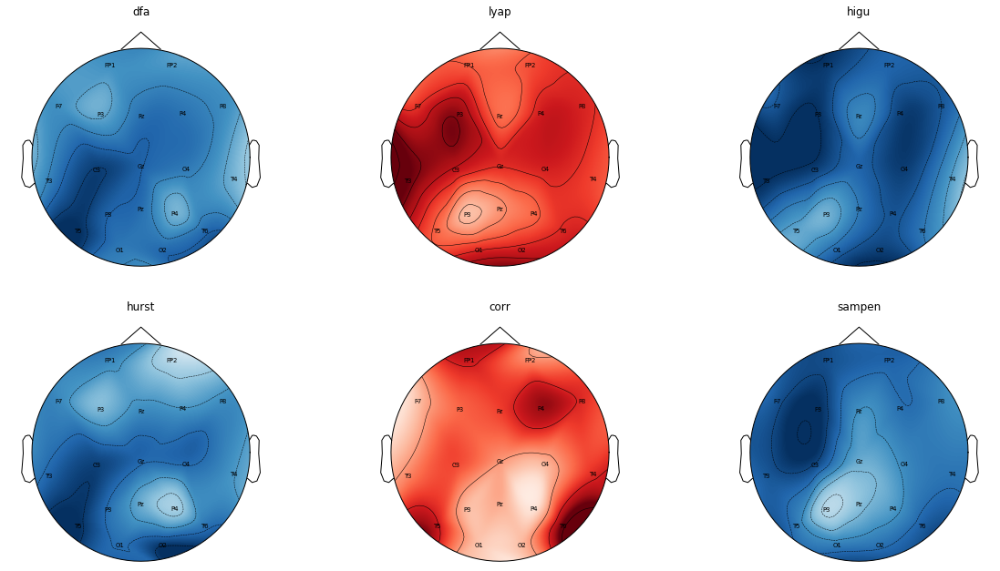

In [46]:
from scipy.stats import pearsonr
def get_corrs(measure):
    df, _, _ = prepare_dfs(measure)
    df.columns = df.columns.droplevel(1)
    df = df.join(metapkl)
    corrs = []
    for chan in CHANNEL_NAMES:
        corrs.append(pearsonr(df[chan], df['dep'])[0])
    return corrs
    
from braindecode.visualization.plot import ax_scalp
from mne.channels import read_montage
mont = read_montage('standard_1020', CHANNEL_NAMES)

info = mne.create_info(mont.ch_names, 250, ch_types='eeg', montage=mont)

fig, ax = plt.subplots(2, 3, figsize=(20, 10), sharex=False, sharey=False)
for i, measure in enumerate(('dfa', 'lyap', 'higu', 'hurst', 'corr', 'sampen',)):
    ax[i//3, i%3].set_title(measure)
    corrs = get_corrs(measure)
    # print(measure)
    # print(corrs)
    mne.viz.plot_topomap(corrs, pos=info, names=mont.ch_names, show_names=True, axes=ax[i//3, i%3], show=False)

plt.show()

# ICA

Creating RawArray with float64 data, n_channels=19, n_times=16931
    Range : 0 ... 16930 =      0.000 ...    67.720 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.7s.
    using multitaper spectrum estimation with 7 DPSS windows


/home/kovar/miniconda3/envs/thesis/lib/python3.6/site-packages/sklearn/decomposition/fastica_.py:121: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning)


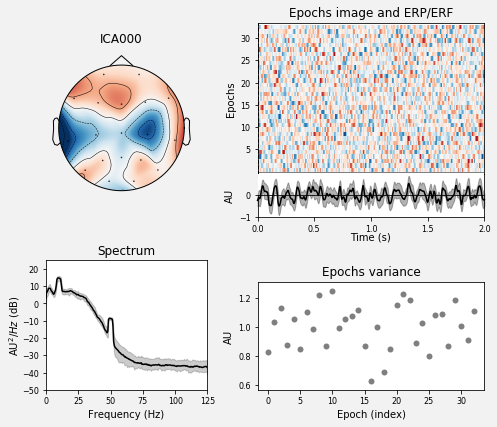

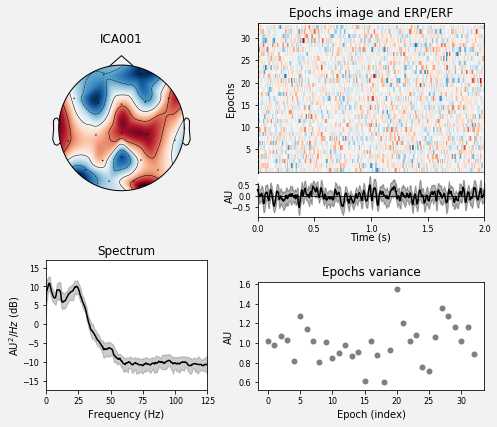

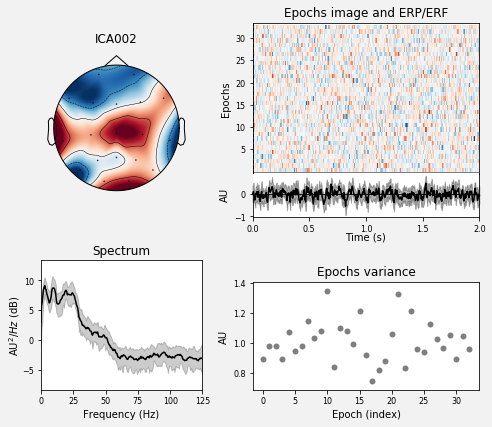

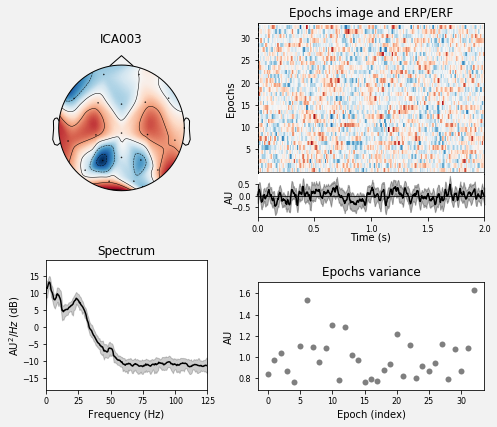

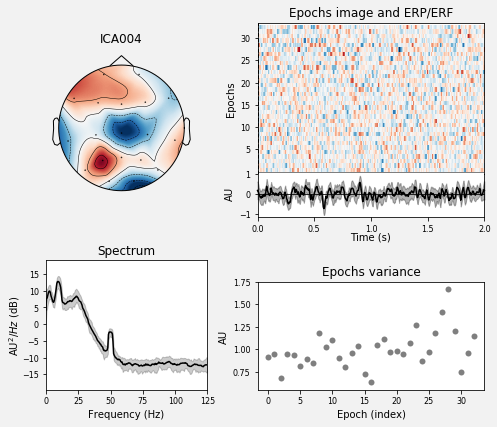

Creating RawArray with float64 data, n_channels=19, n_times=84589
    Range : 0 ... 84588 =      0.000 ...   338.352 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.5s.
    using multitaper spectrum estimation with 7 DPSS windows


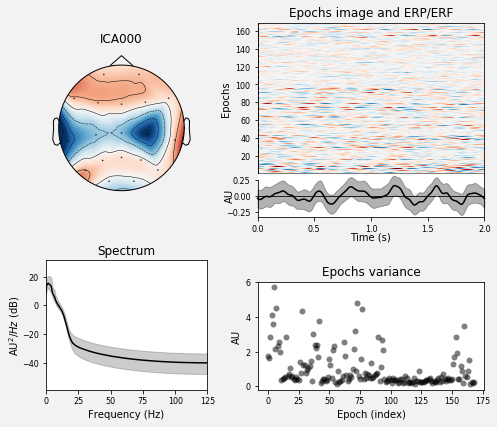

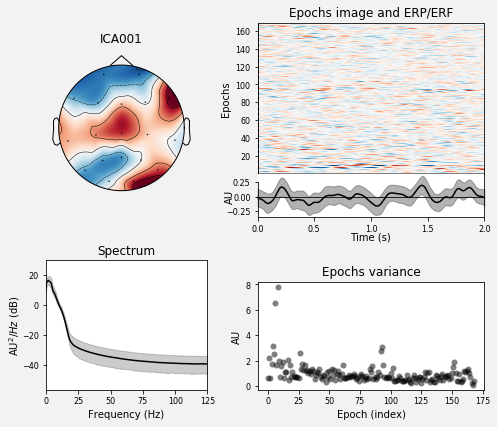

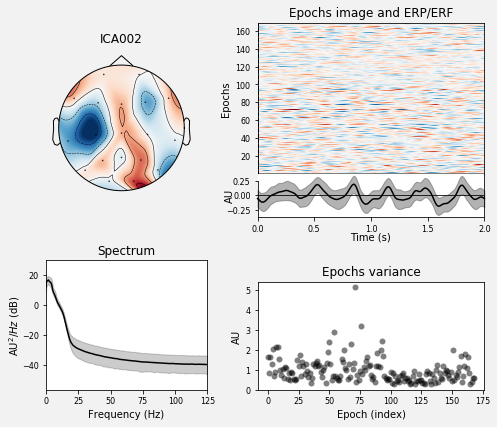

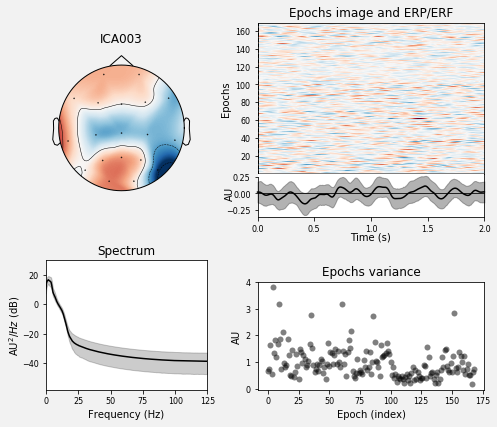

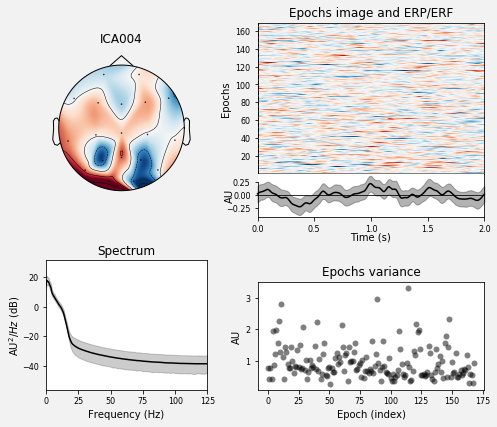

Creating RawArray with float64 data, n_channels=19, n_times=62550
    Range : 0 ... 62549 =      0.000 ...   250.196 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 2.1s.
    using multitaper spectrum estimation with 7 DPSS windows


/home/kovar/miniconda3/envs/thesis/lib/python3.6/site-packages/sklearn/decomposition/fastica_.py:121: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning)


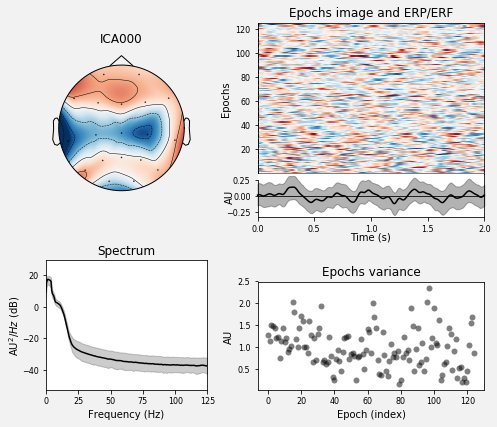

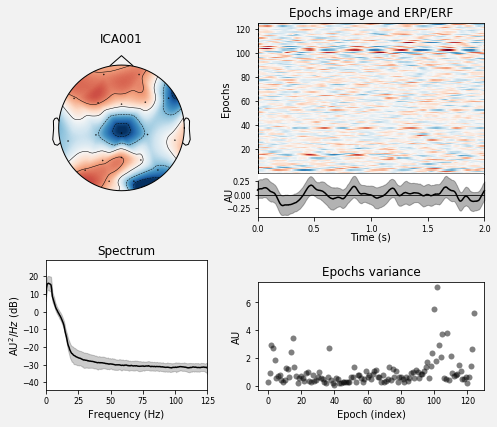

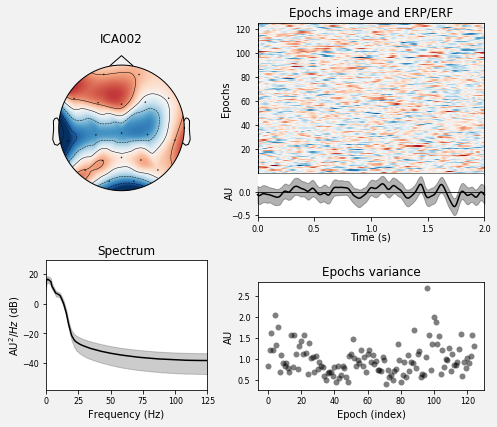

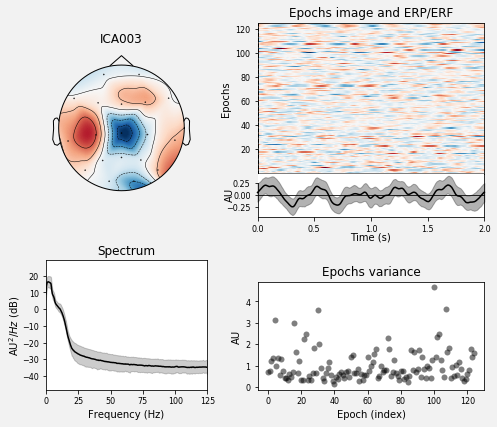

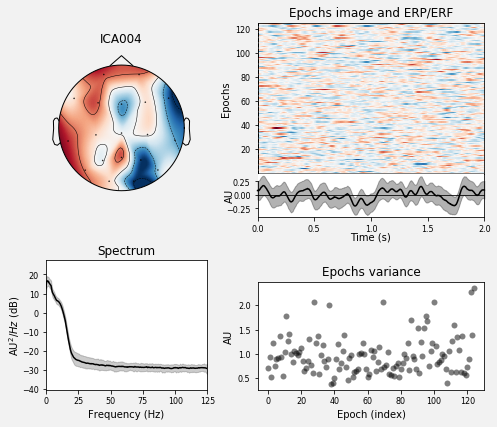

Creating RawArray with float64 data, n_channels=19, n_times=15661
    Range : 0 ... 15660 =      0.000 ...    62.640 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19
Fitting ICA took 0.1s.
    using multitaper spectrum estimation with 7 DPSS windows


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


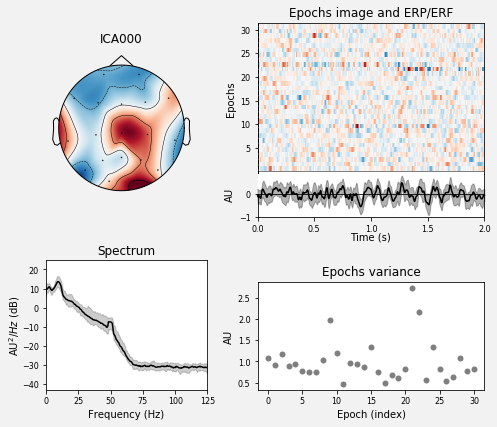

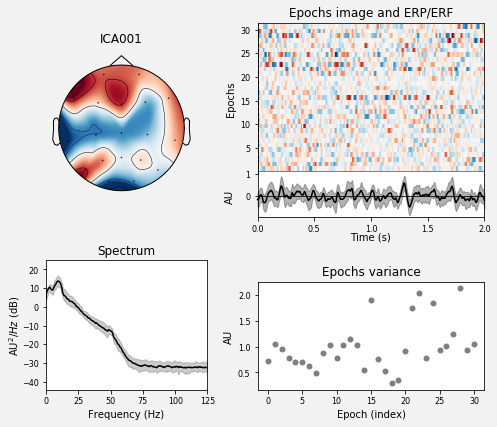

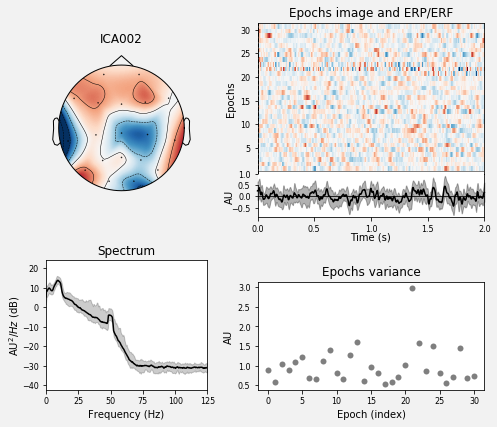

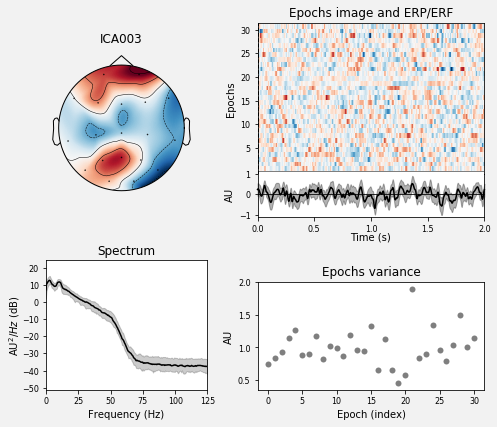

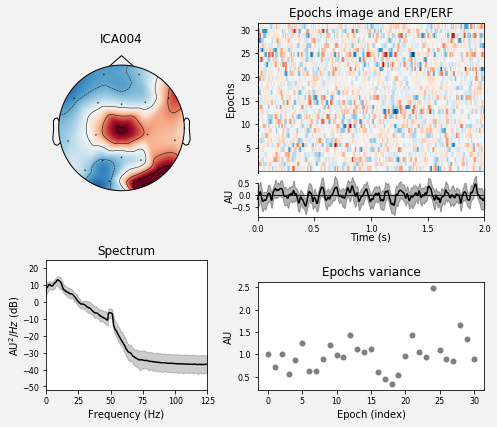

Creating RawArray with float64 data, n_channels=19, n_times=18016
    Range : 0 ... 18015 =      0.000 ...    72.060 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.3s.
    using multitaper spectrum estimation with 7 DPSS windows


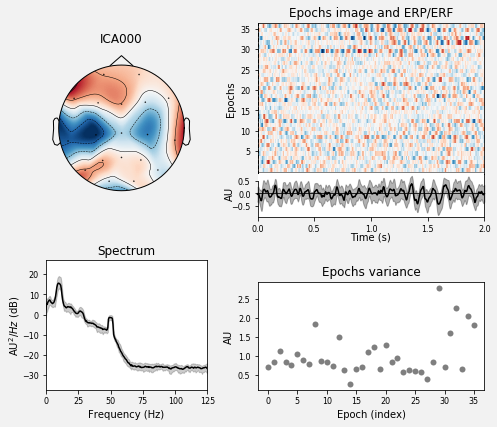

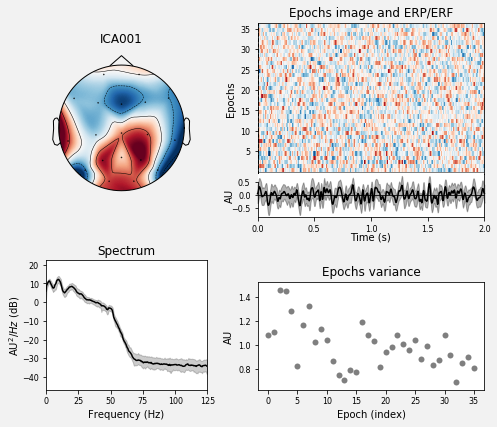

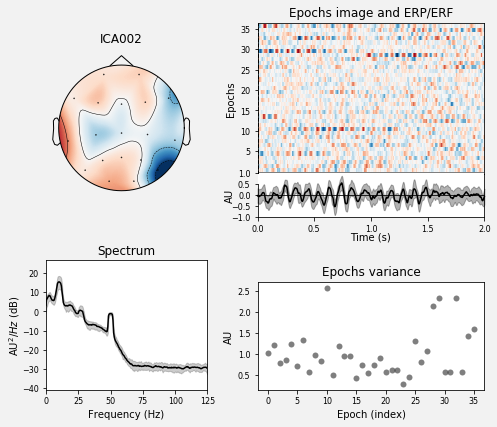

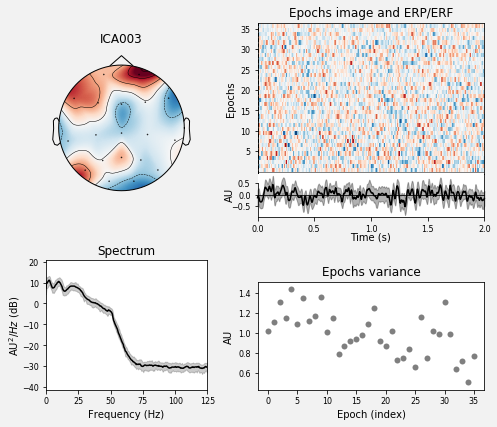

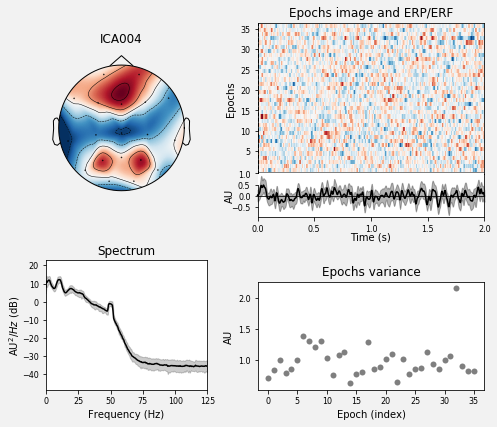

Creating RawArray with float64 data, n_channels=19, n_times=27295
    Range : 0 ... 27294 =      0.000 ...   109.176 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.2s.
    using multitaper spectrum estimation with 7 DPSS windows


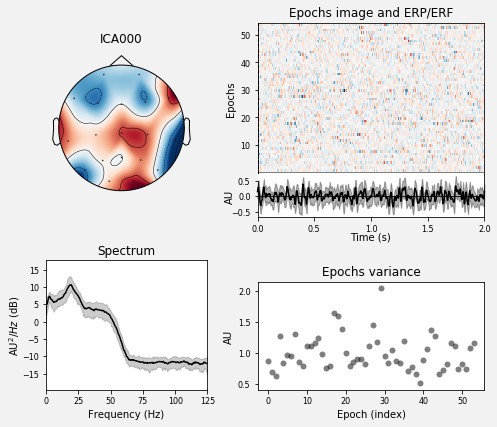

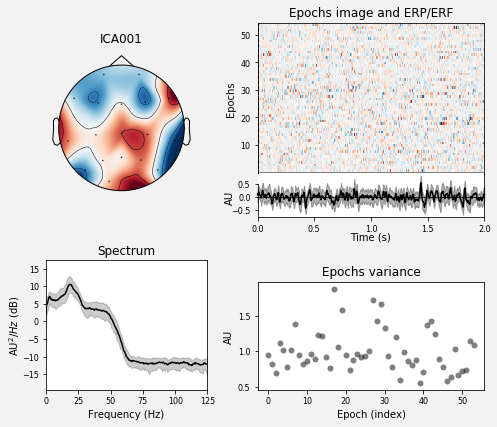

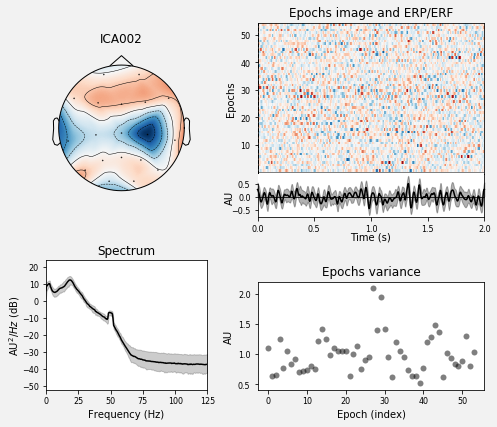

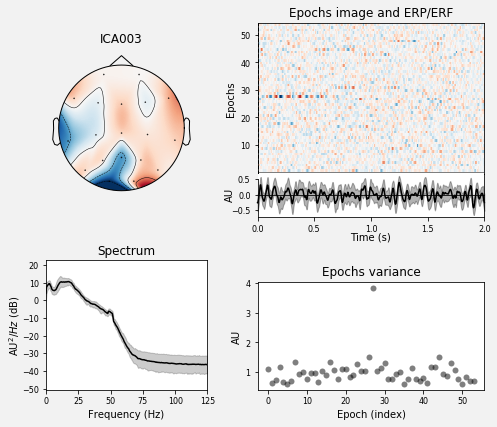

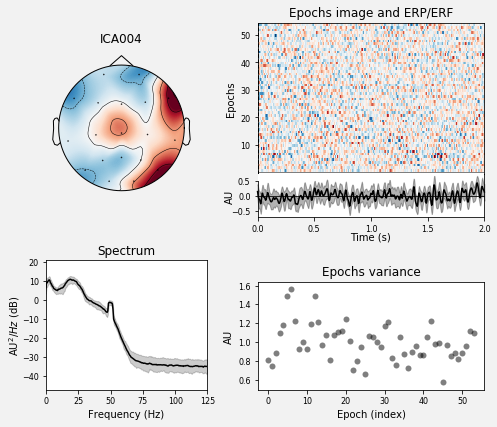

Creating RawArray with float64 data, n_channels=19, n_times=34196
    Range : 0 ... 34195 =      0.000 ...   136.780 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.8s.
    using multitaper spectrum estimation with 7 DPSS windows


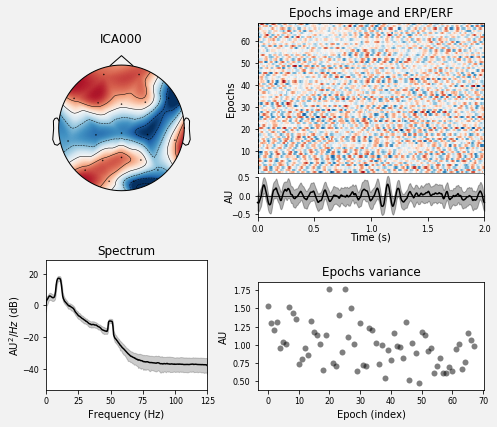

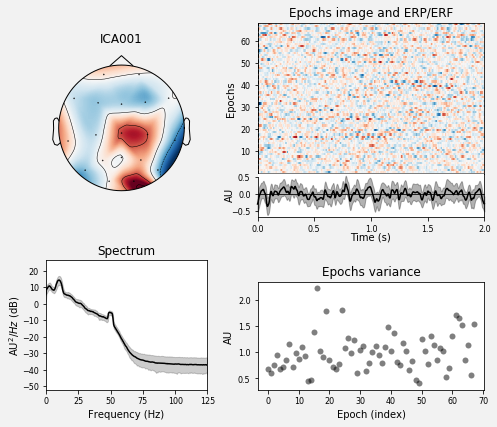

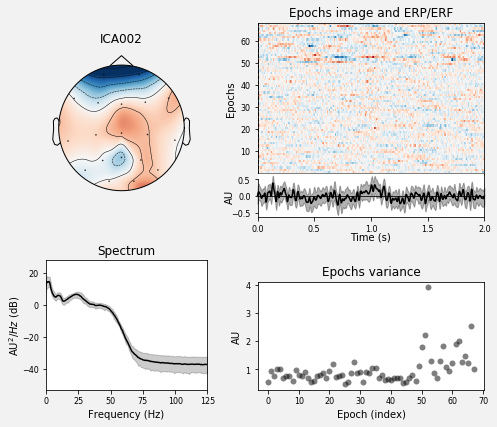

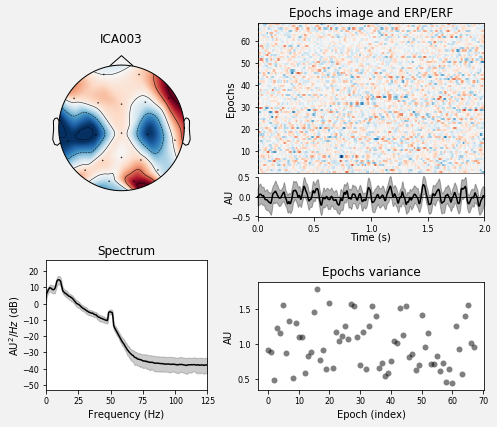

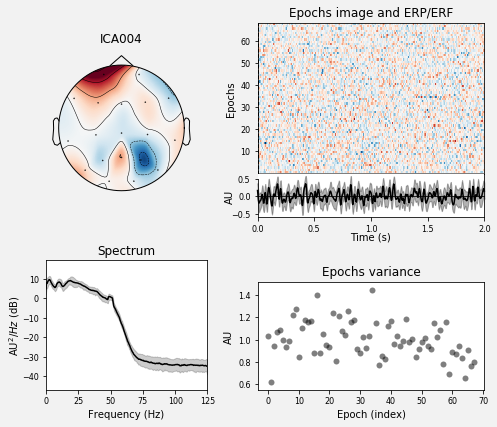

Creating RawArray with float64 data, n_channels=19, n_times=21166
    Range : 0 ... 21165 =      0.000 ...    84.660 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.4s.
    using multitaper spectrum estimation with 7 DPSS windows


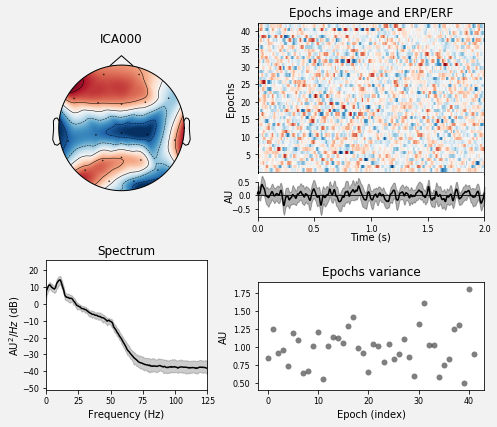

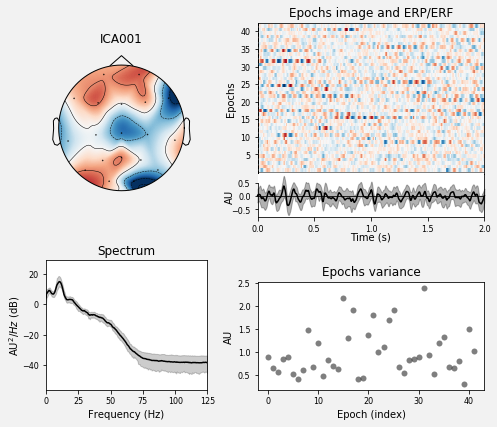

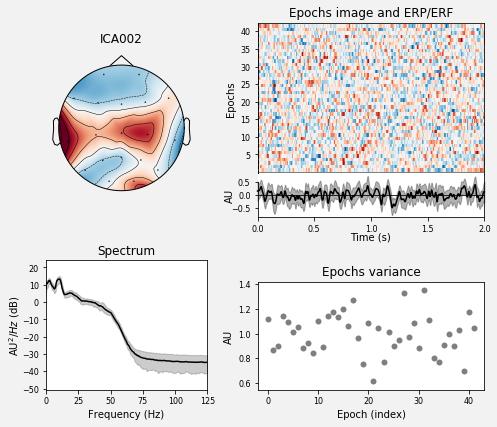

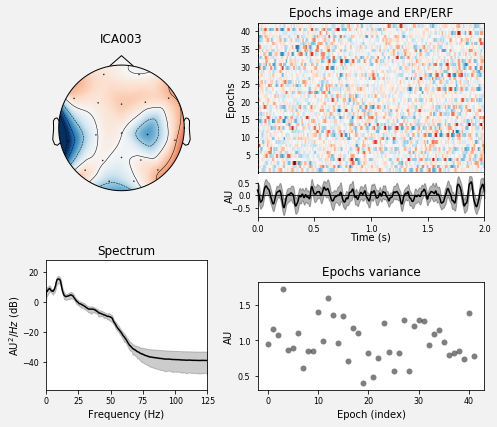

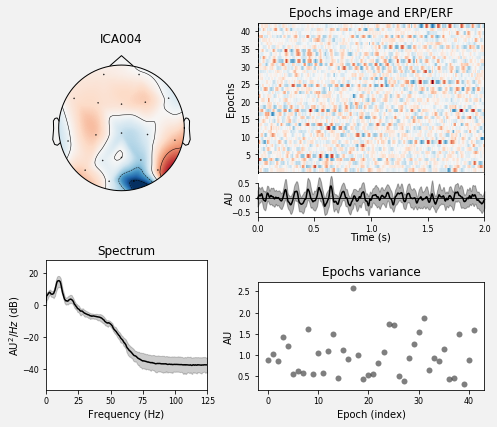

Creating RawArray with float64 data, n_channels=19, n_times=15832
    Range : 0 ... 15831 =      0.000 ...    63.324 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.2s.
    using multitaper spectrum estimation with 7 DPSS windows


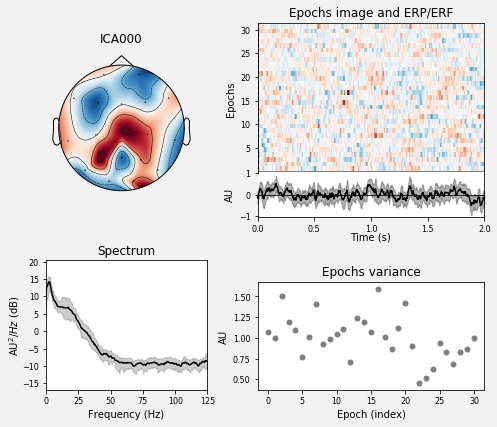

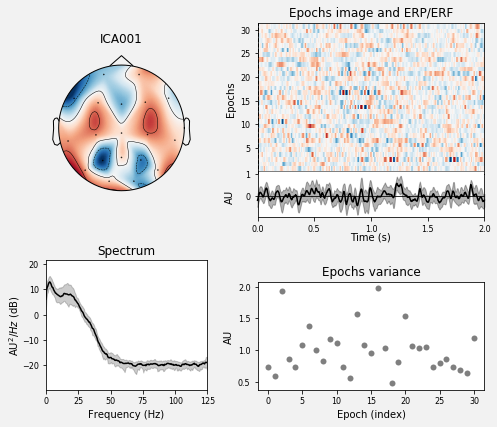

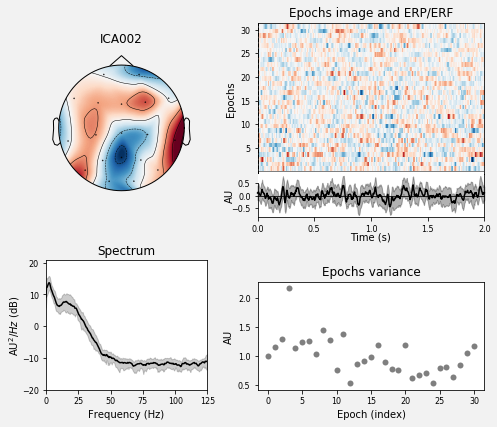

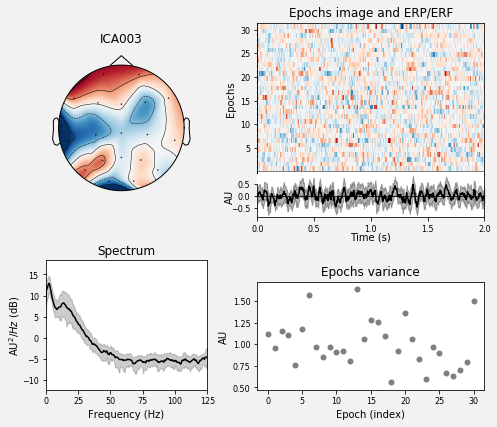

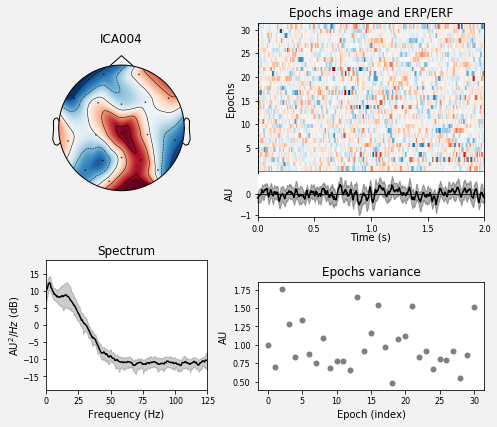

Creating RawArray with float64 data, n_channels=19, n_times=15009
    Range : 0 ... 15008 =      0.000 ...    60.032 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.2s.
    using multitaper spectrum estimation with 7 DPSS windows


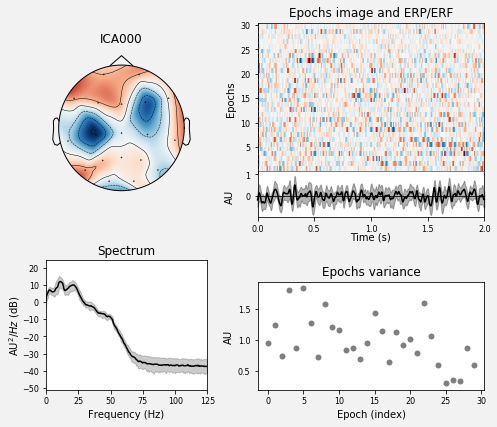

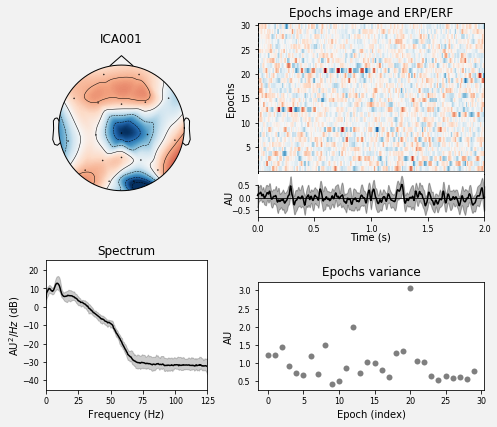

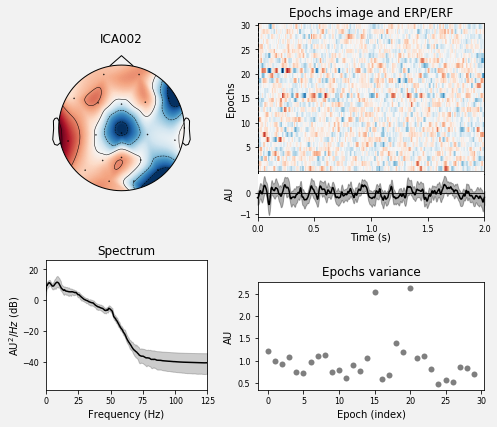

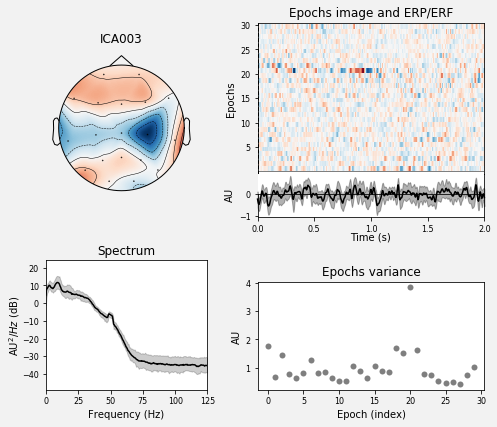

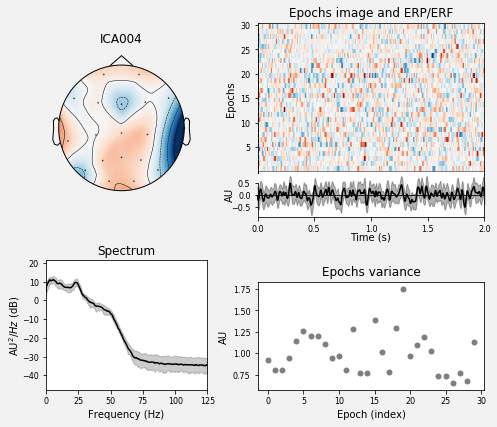

Creating RawArray with float64 data, n_channels=19, n_times=15801
    Range : 0 ... 15800 =      0.000 ...    63.200 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.6s.


/home/kovar/miniconda3/envs/thesis/lib/python3.6/site-packages/sklearn/decomposition/fastica_.py:121: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning)


    using multitaper spectrum estimation with 7 DPSS windows


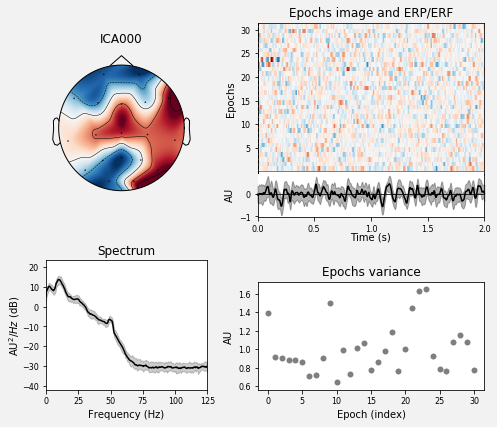

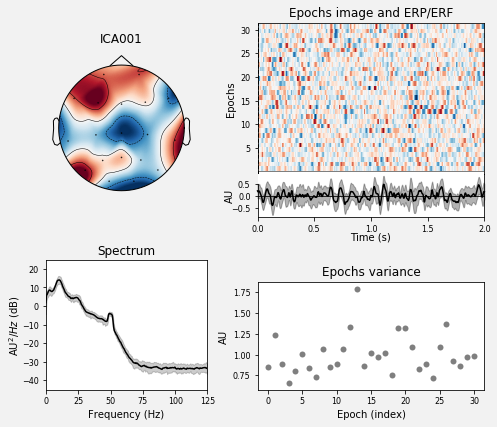

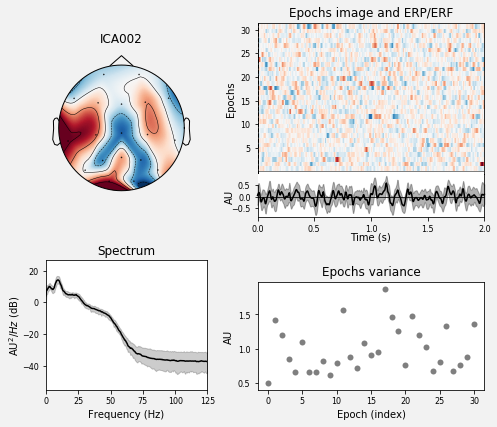

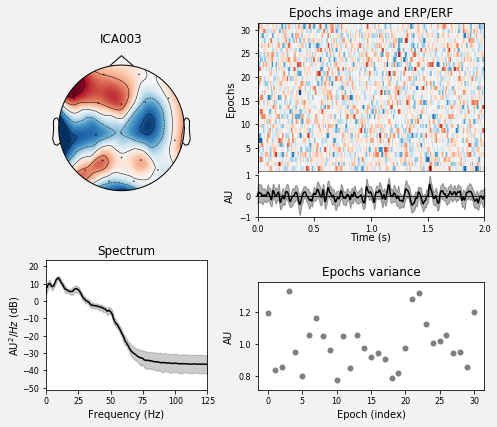

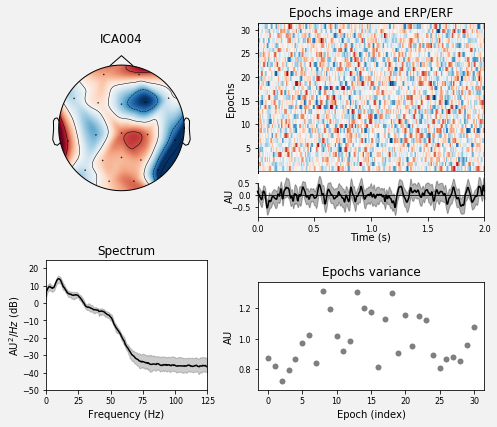

Creating RawArray with float64 data, n_channels=19, n_times=23917
    Range : 0 ... 23916 =      0.000 ...    95.664 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.6s.
    using multitaper spectrum estimation with 7 DPSS windows


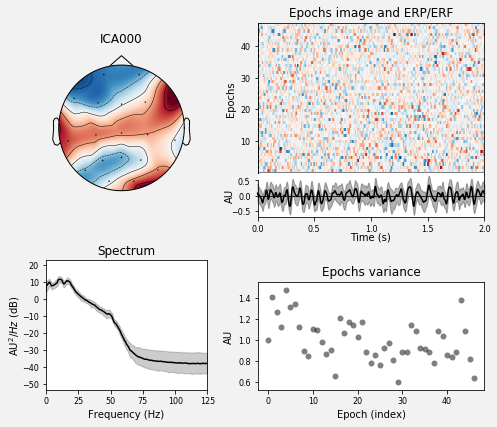

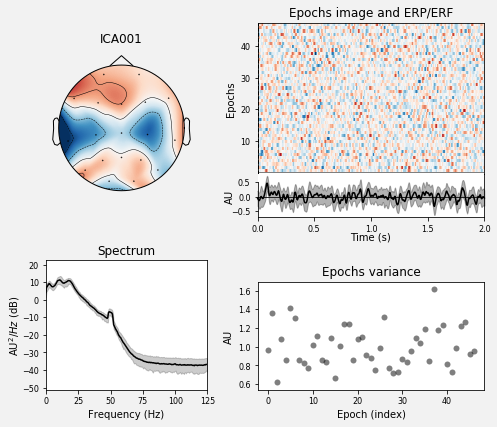

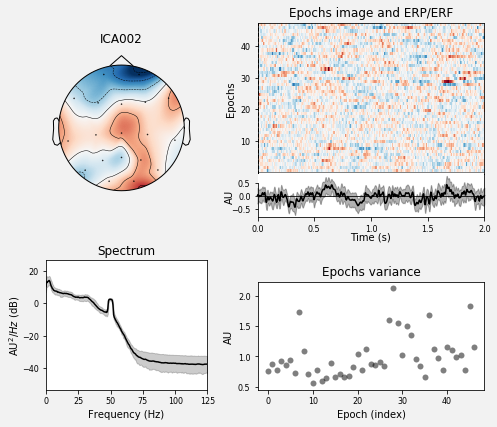

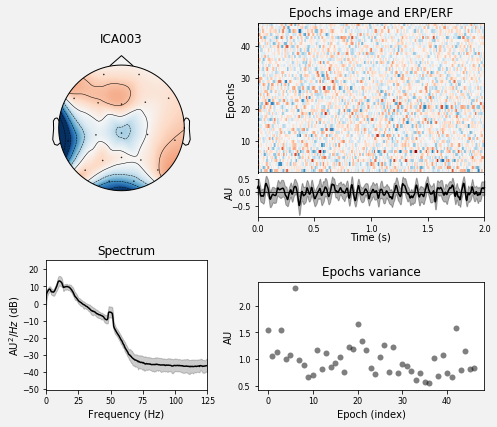

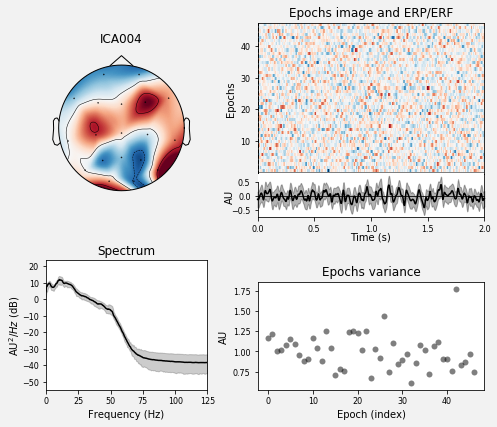

Creating RawArray with float64 data, n_channels=19, n_times=18778
    Range : 0 ... 18777 =      0.000 ...    75.108 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.7s.
    using multitaper spectrum estimation with 7 DPSS windows


/home/kovar/miniconda3/envs/thesis/lib/python3.6/site-packages/sklearn/decomposition/fastica_.py:121: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning)


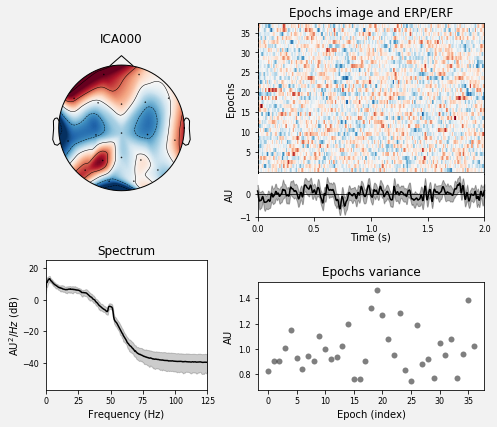

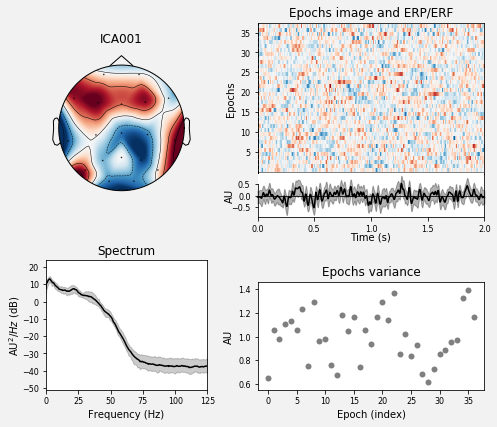

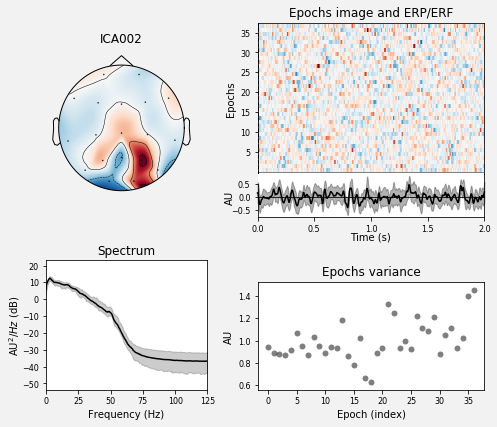

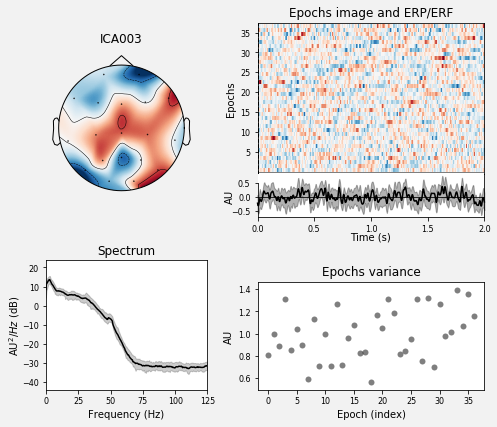

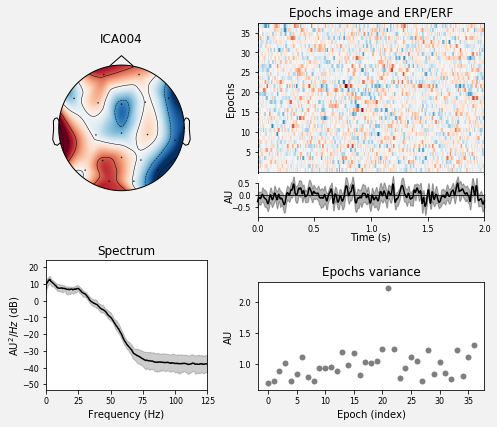

Creating RawArray with float64 data, n_channels=19, n_times=21861
    Range : 0 ... 21860 =      0.000 ...    87.440 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.7s.
    using multitaper spectrum estimation with 7 DPSS windows


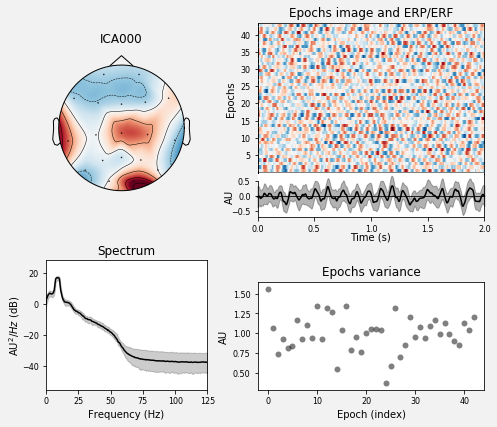

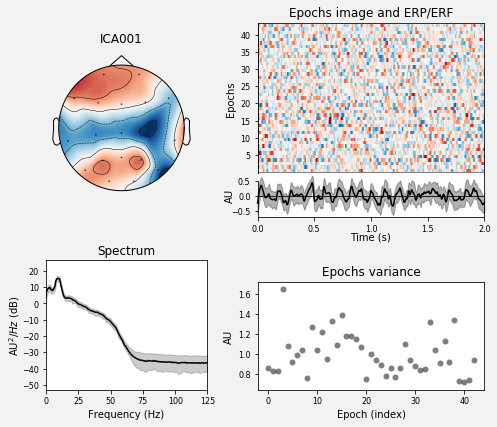

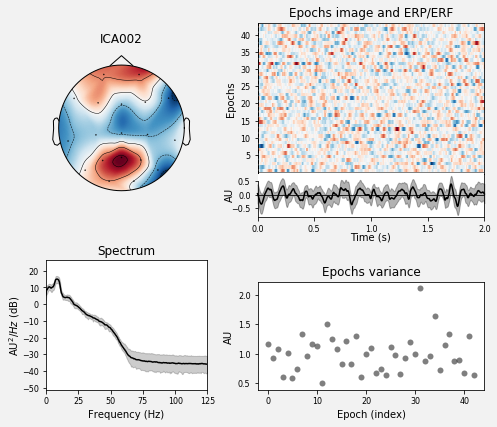

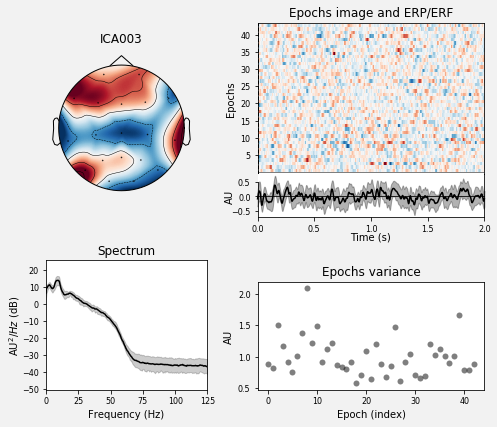

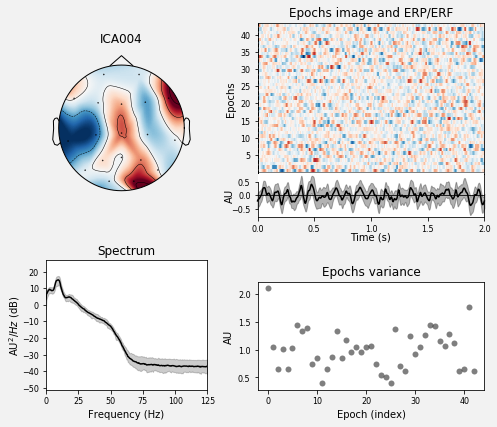

Creating RawArray with float64 data, n_channels=19, n_times=13760
    Range : 0 ... 13759 =      0.000 ...    55.036 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.5s.
    using multitaper spectrum estimation with 7 DPSS windows


/home/kovar/miniconda3/envs/thesis/lib/python3.6/site-packages/sklearn/decomposition/fastica_.py:121: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning)


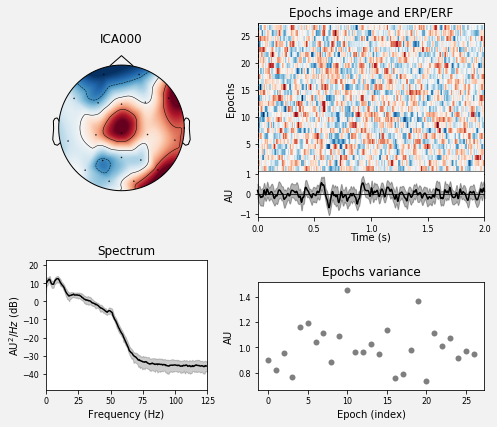

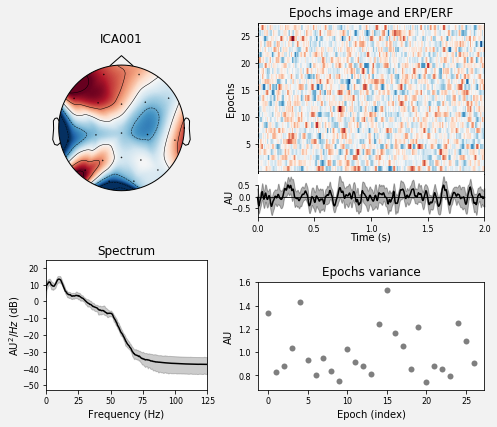

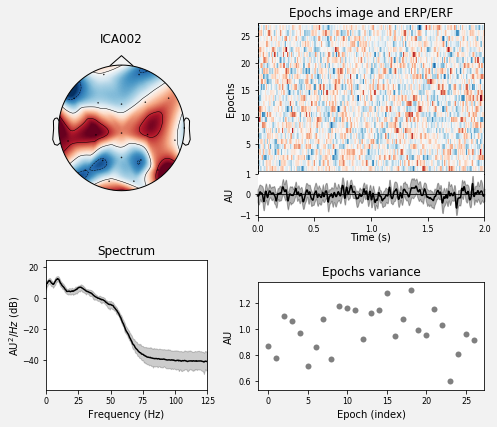

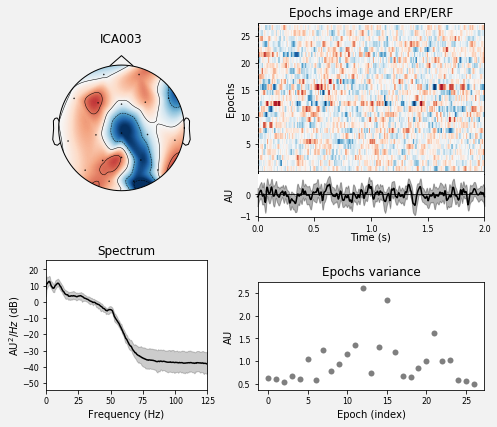

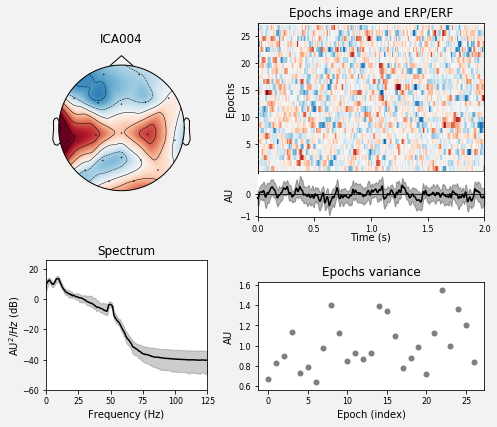

Creating RawArray with float64 data, n_channels=19, n_times=13453
    Range : 0 ... 13452 =      0.000 ...    53.808 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.5s.
    using multitaper spectrum estimation with 7 DPSS windows


/home/kovar/miniconda3/envs/thesis/lib/python3.6/site-packages/sklearn/decomposition/fastica_.py:121: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning)


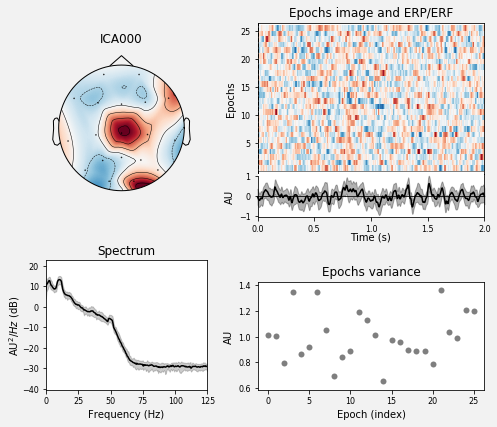

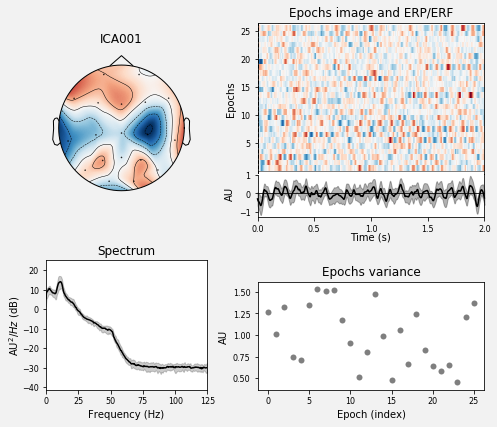

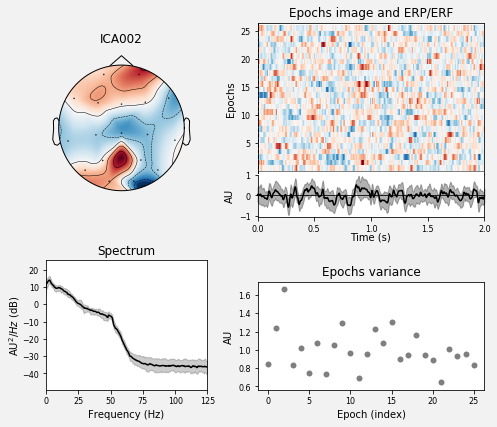

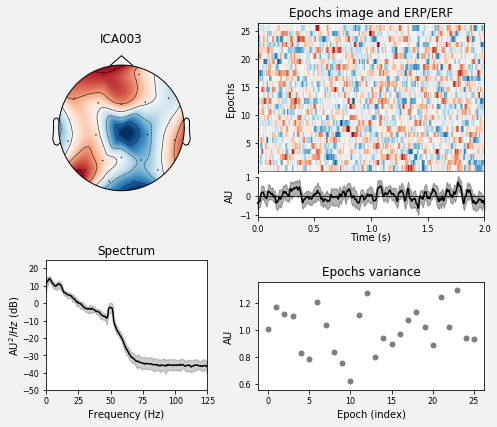

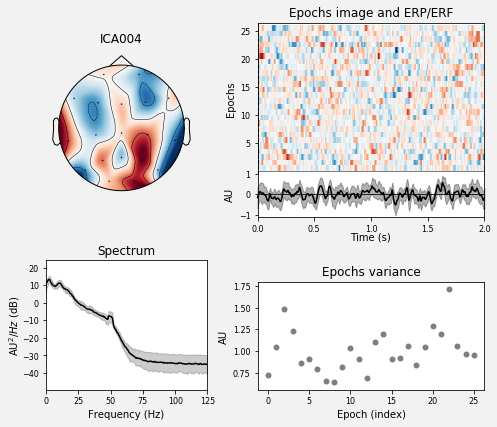

Creating RawArray with float64 data, n_channels=19, n_times=20196
    Range : 0 ... 20195 =      0.000 ...    80.780 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.8s.
    using multitaper spectrum estimation with 7 DPSS windows


/home/kovar/miniconda3/envs/thesis/lib/python3.6/site-packages/sklearn/decomposition/fastica_.py:121: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning)


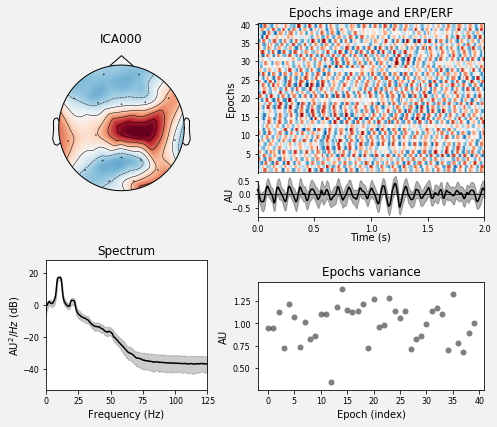

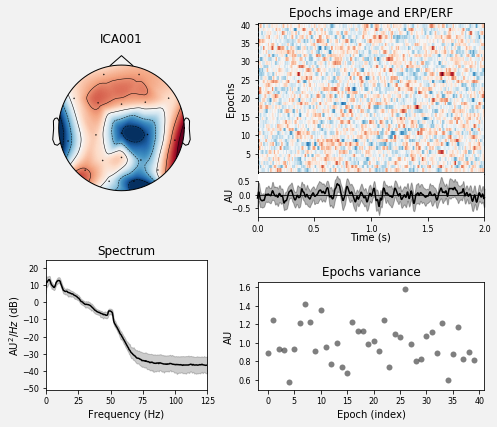

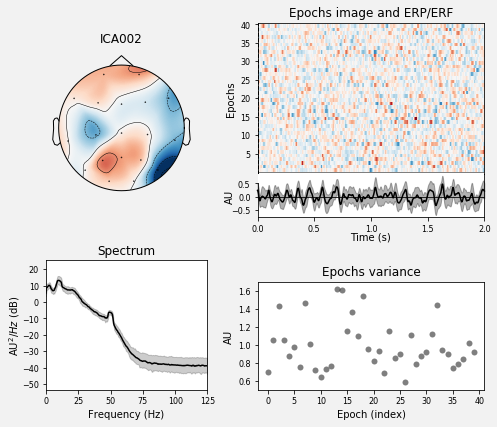

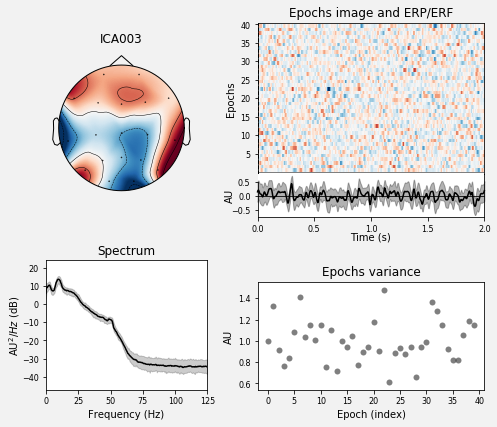

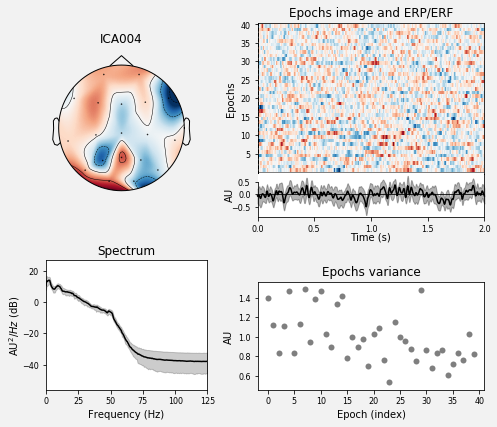

Creating RawArray with float64 data, n_channels=19, n_times=15806
    Range : 0 ... 15805 =      0.000 ...    63.220 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.6s.
    using multitaper spectrum estimation with 7 DPSS windows


/home/kovar/miniconda3/envs/thesis/lib/python3.6/site-packages/sklearn/decomposition/fastica_.py:121: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning)


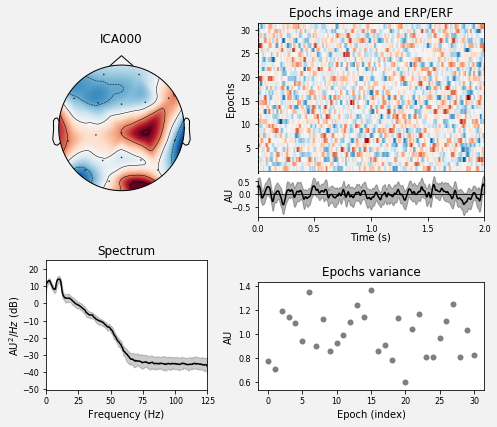

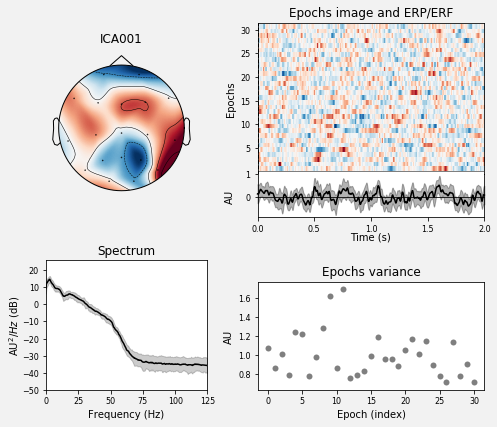

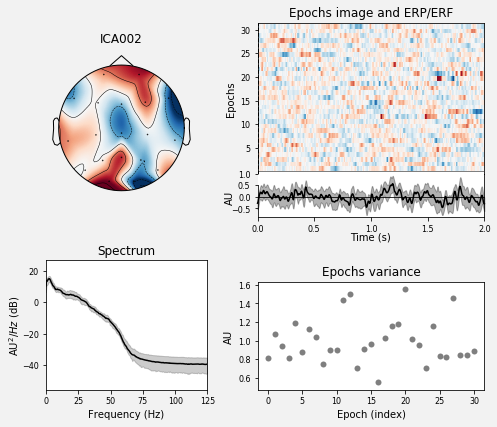

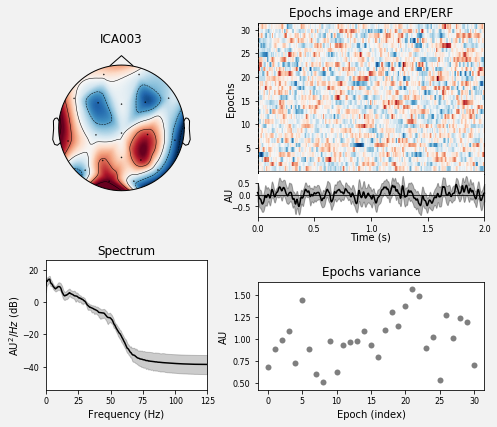

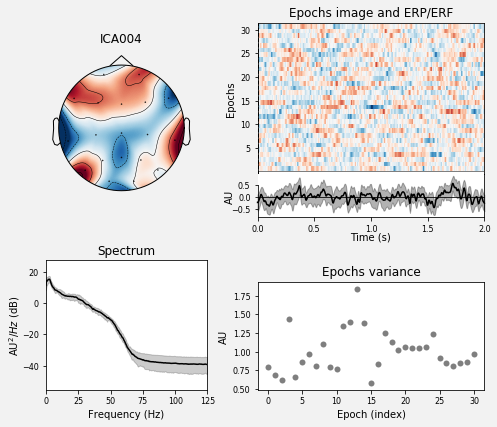

Creating RawArray with float64 data, n_channels=19, n_times=110376
    Range : 0 ... 110375 =      0.000 ...   441.500 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 1.3s.
    using multitaper spectrum estimation with 7 DPSS windows


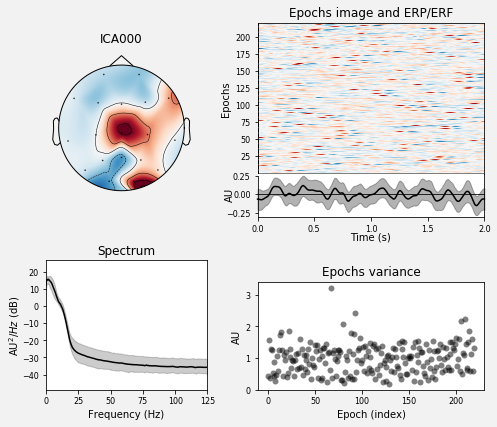

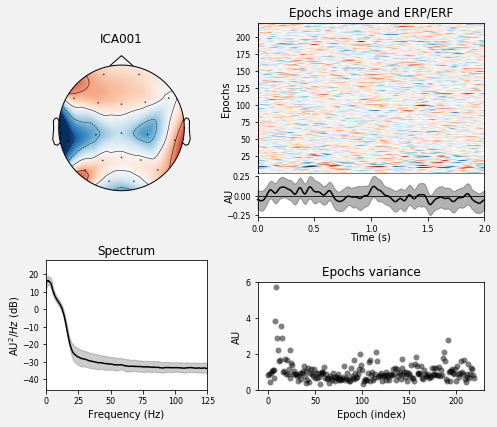

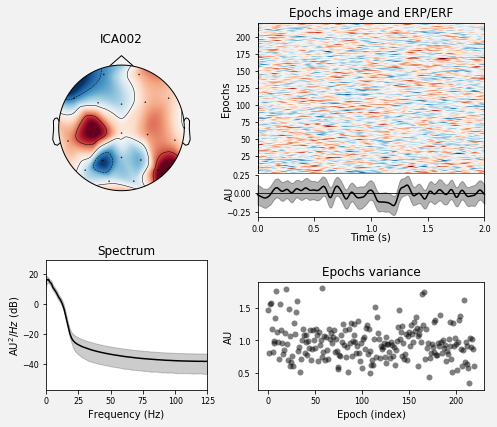

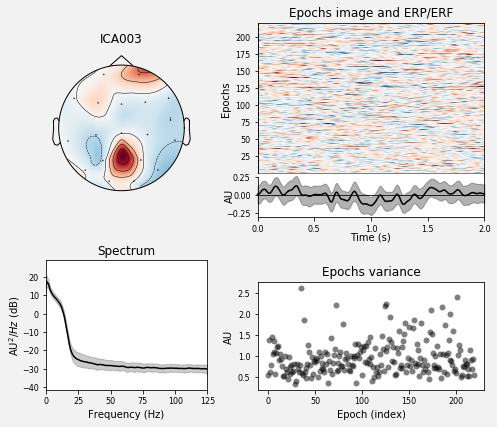

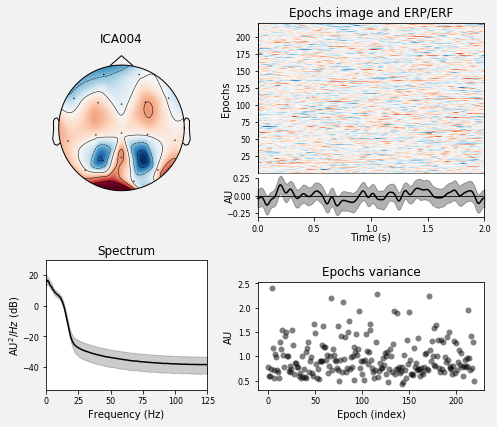

Creating RawArray with float64 data, n_channels=19, n_times=19358
    Range : 0 ... 19357 =      0.000 ...    77.428 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.7s.
    using multitaper spectrum estimation with 7 DPSS windows


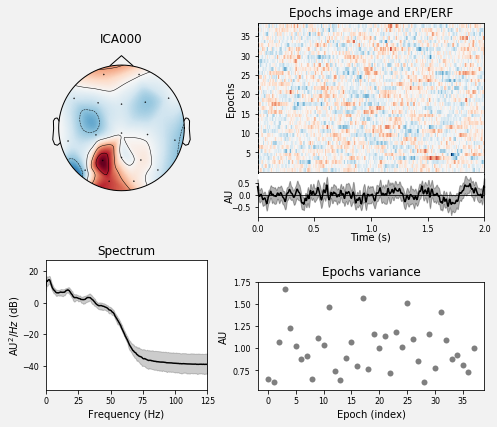

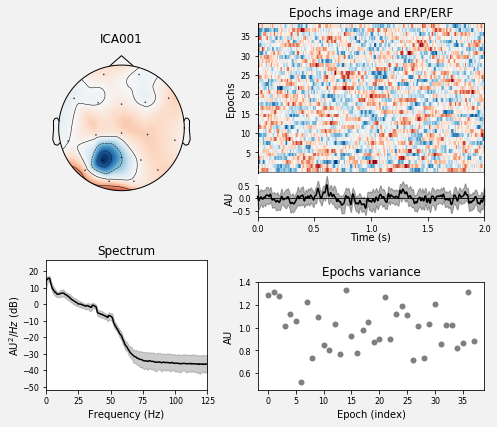

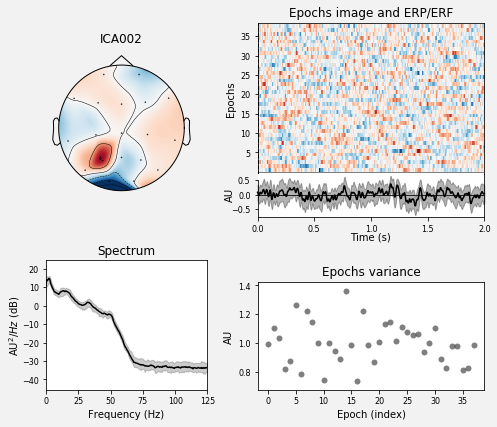

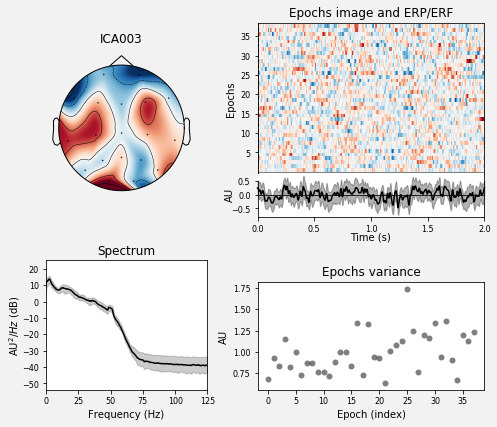

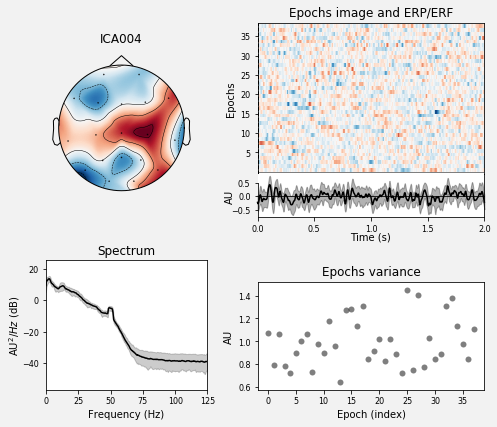

Creating RawArray with float64 data, n_channels=19, n_times=24443
    Range : 0 ... 24442 =      0.000 ...    97.768 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.6s.
    using multitaper spectrum estimation with 7 DPSS windows


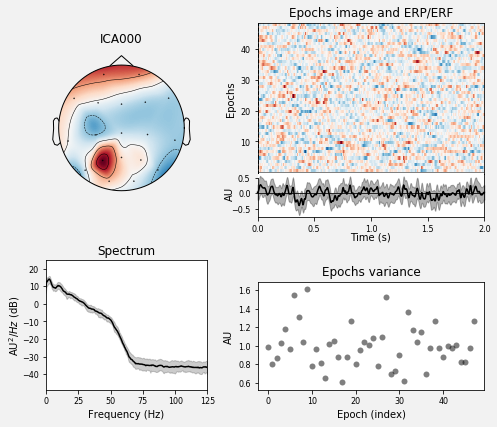

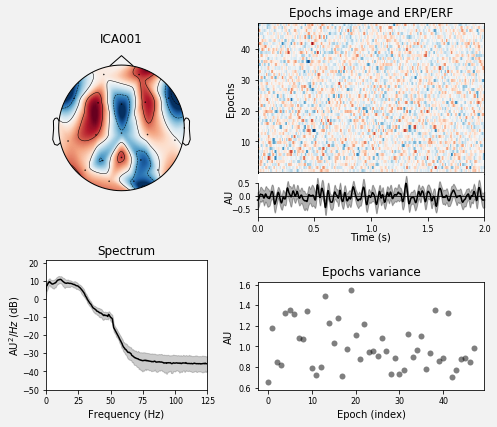

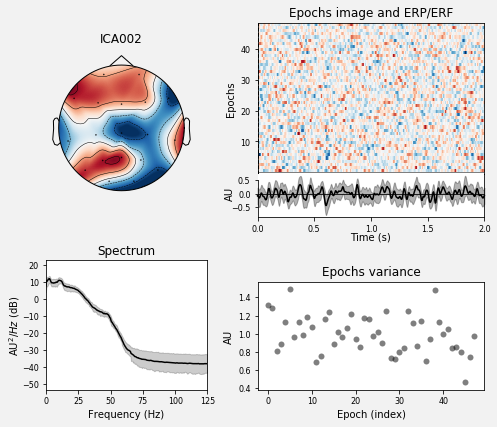

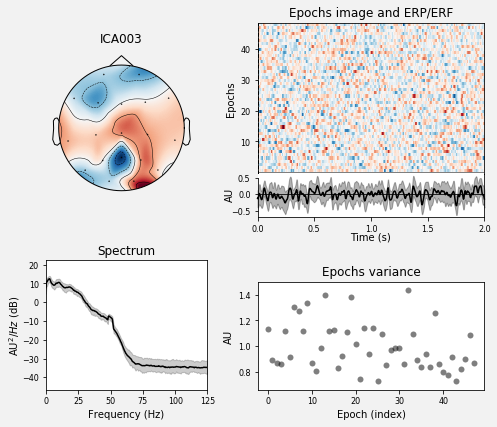

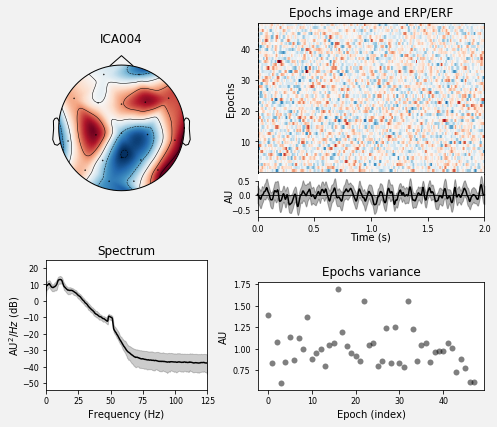

Creating RawArray with float64 data, n_channels=19, n_times=15623
    Range : 0 ... 15622 =      0.000 ...    62.488 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.6s.
    using multitaper spectrum estimation with 7 DPSS windows


/home/kovar/miniconda3/envs/thesis/lib/python3.6/site-packages/sklearn/decomposition/fastica_.py:121: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning)


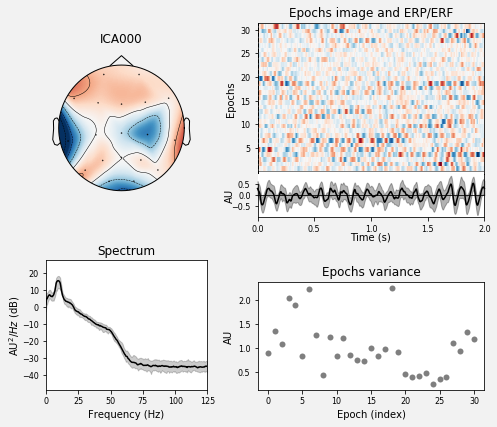

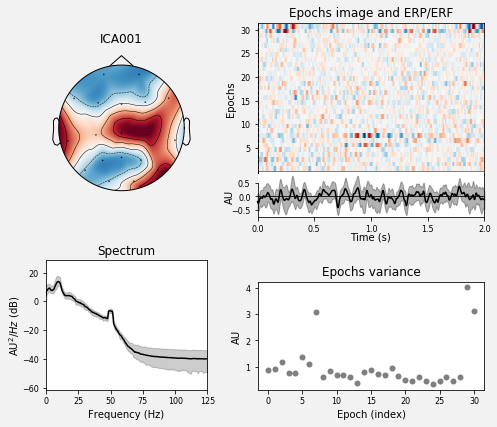

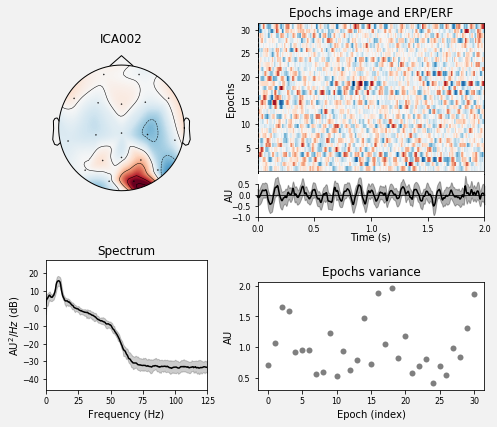

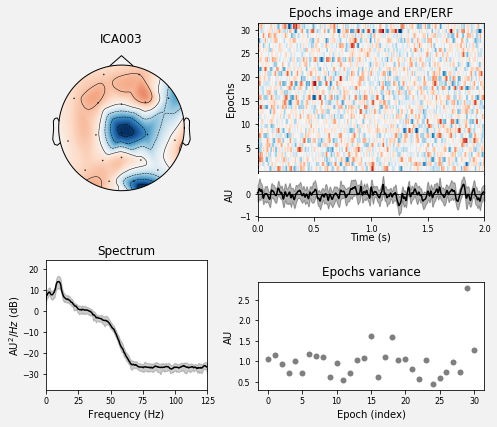

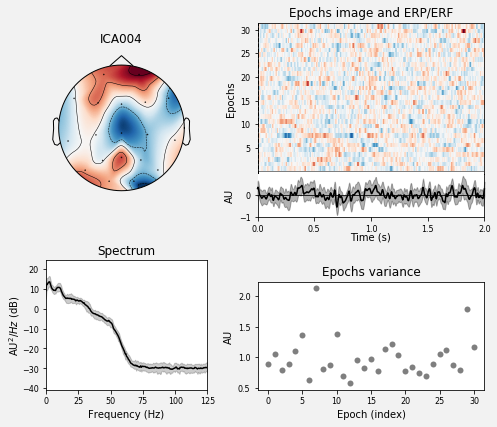

Creating RawArray with float64 data, n_channels=19, n_times=25962
    Range : 0 ... 25961 =      0.000 ...   103.844 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.3s.
    using multitaper spectrum estimation with 7 DPSS windows


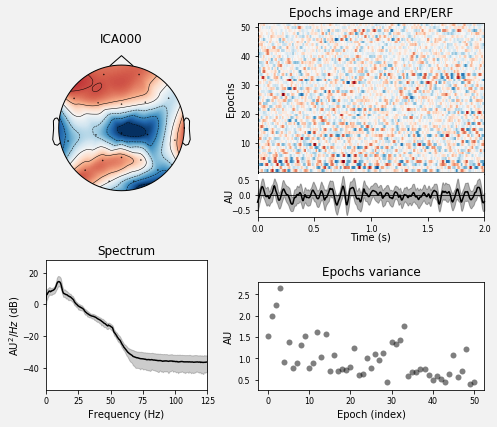

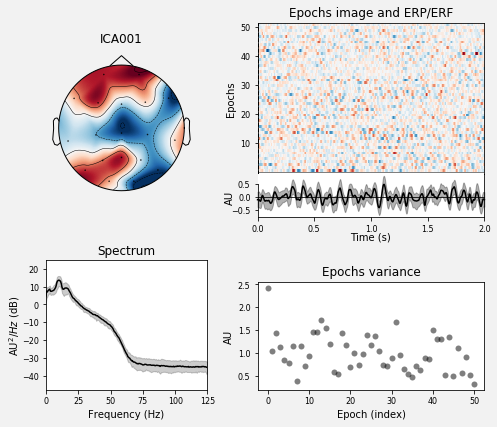

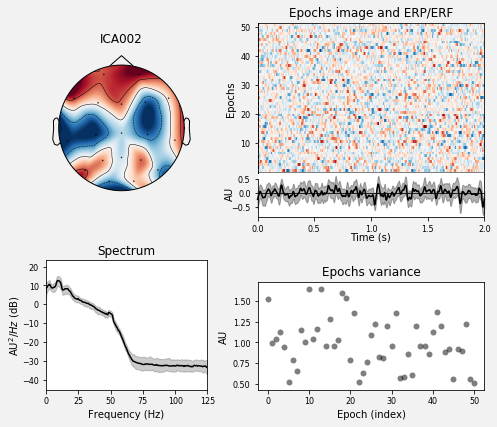

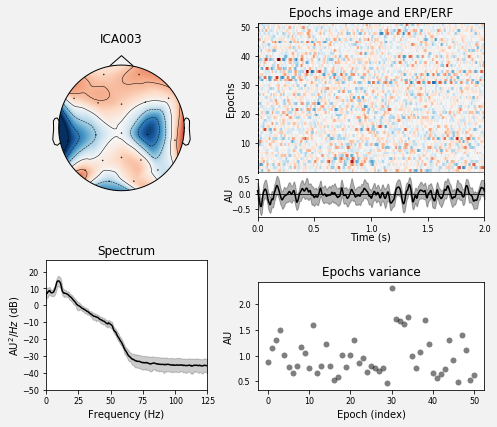

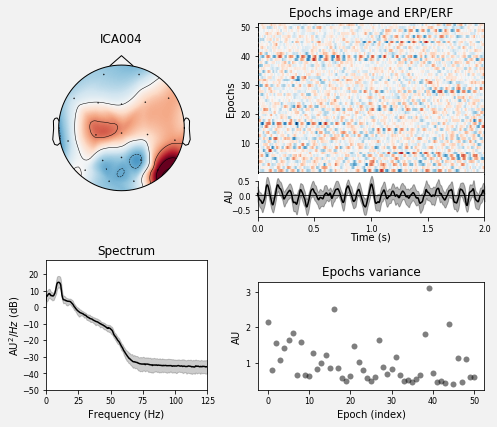

Creating RawArray with float64 data, n_channels=19, n_times=31311
    Range : 0 ... 31310 =      0.000 ...   125.240 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.9s.
    using multitaper spectrum estimation with 7 DPSS windows


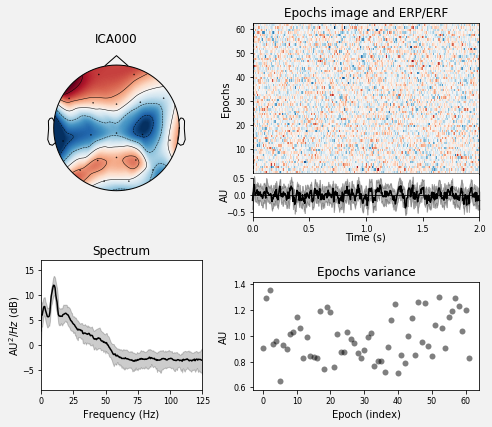

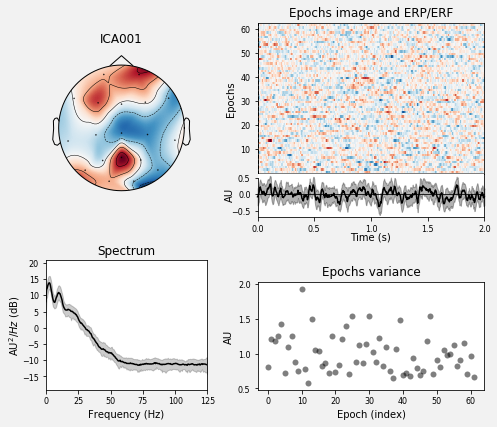

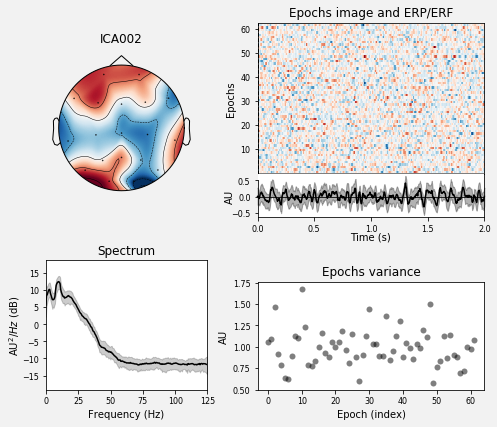

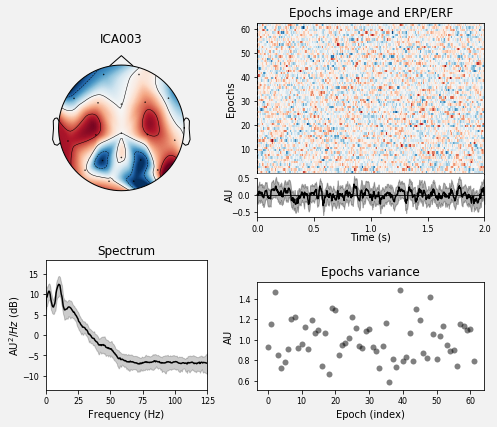

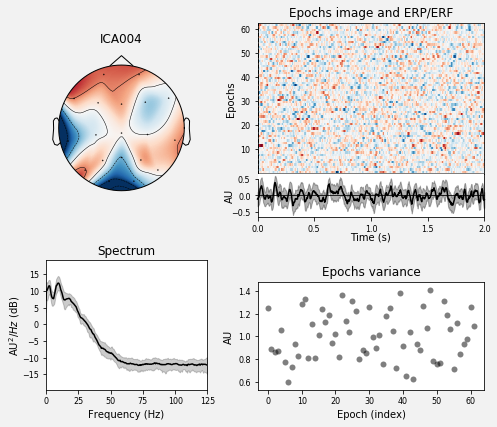

Creating RawArray with float64 data, n_channels=19, n_times=5888
    Range : 0 ... 5887 =      0.000 ...    23.548 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.3s.
    using multitaper spectrum estimation with 7 DPSS windows


/home/kovar/miniconda3/envs/thesis/lib/python3.6/site-packages/sklearn/decomposition/fastica_.py:121: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning)


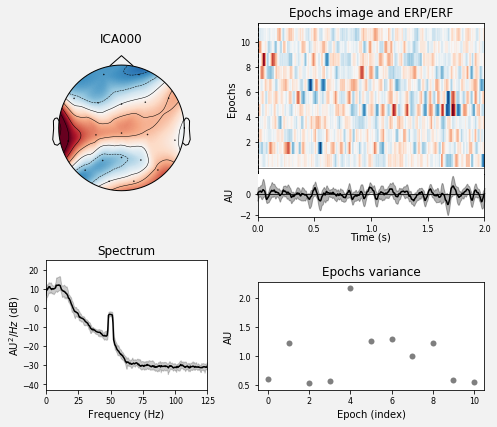

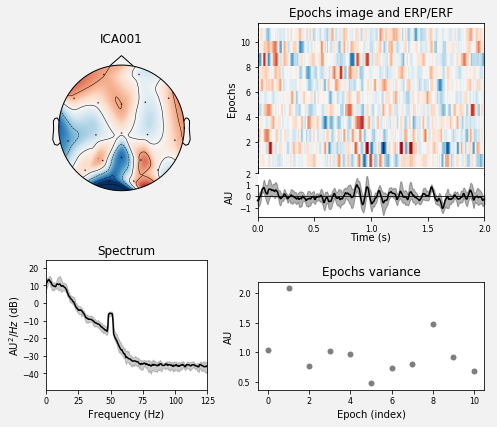

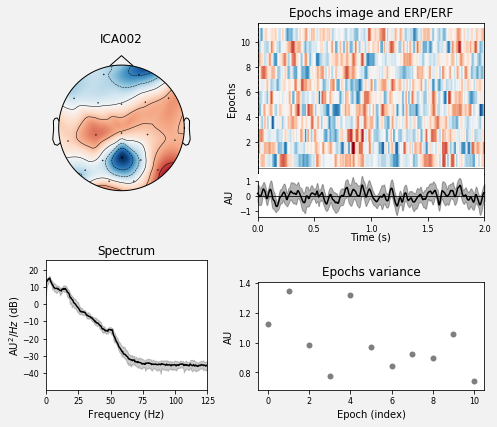

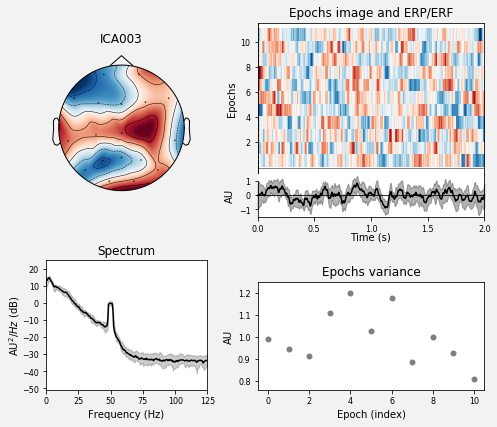

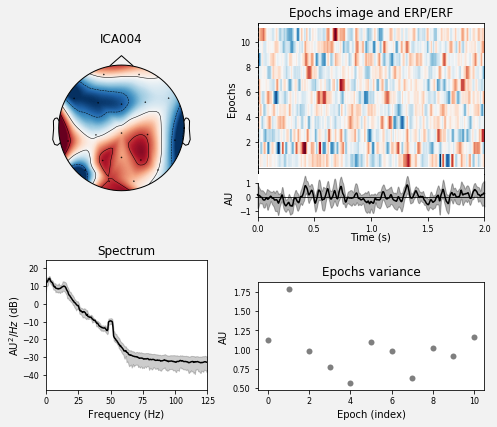

Creating RawArray with float64 data, n_channels=19, n_times=17507
    Range : 0 ... 17506 =      0.000 ...    70.024 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19
Fitting ICA took 0.1s.


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


    using multitaper spectrum estimation with 7 DPSS windows


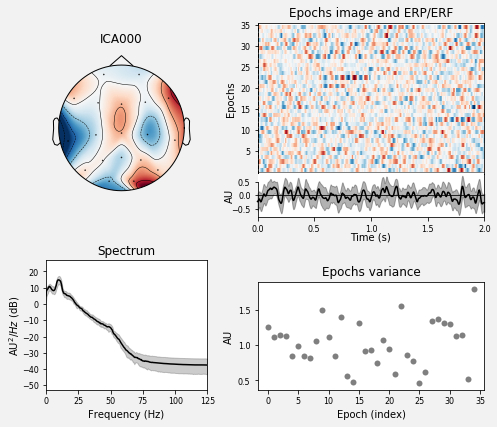

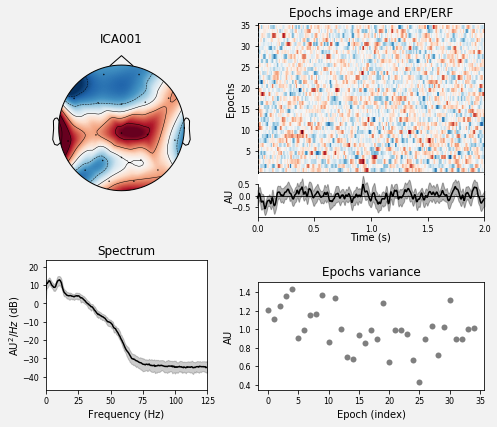

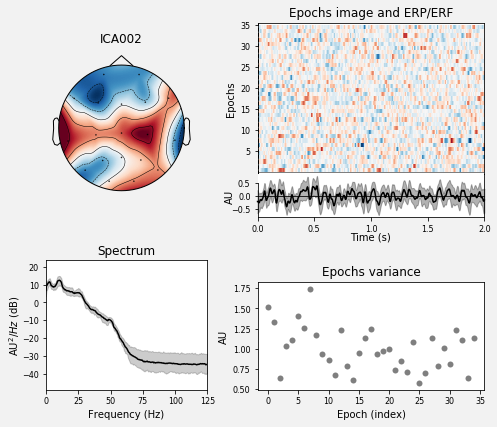

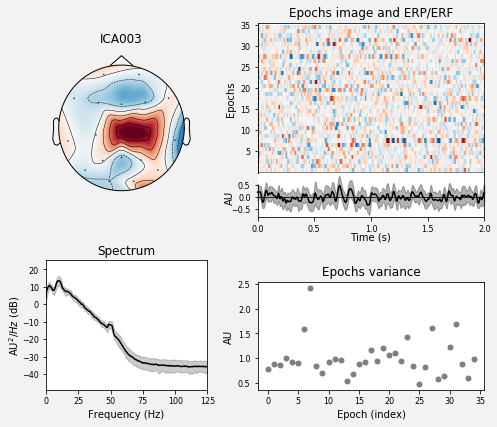

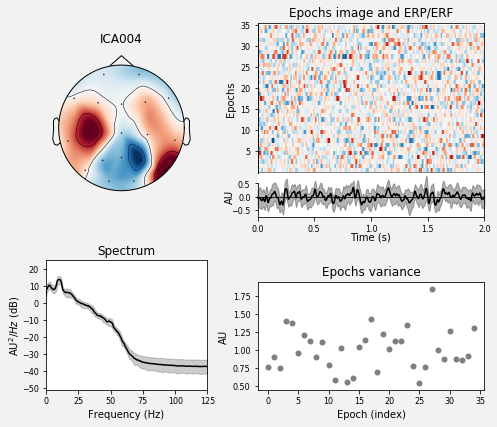

Creating RawArray with float64 data, n_channels=19, n_times=21898
    Range : 0 ... 21897 =      0.000 ...    87.588 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.8s.
    using multitaper spectrum estimation with 7 DPSS windows


/home/kovar/miniconda3/envs/thesis/lib/python3.6/site-packages/sklearn/decomposition/fastica_.py:121: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning)


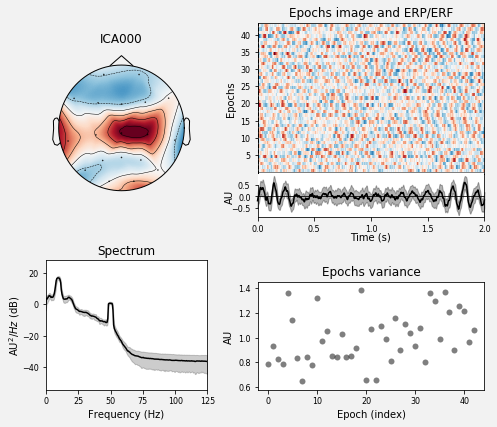

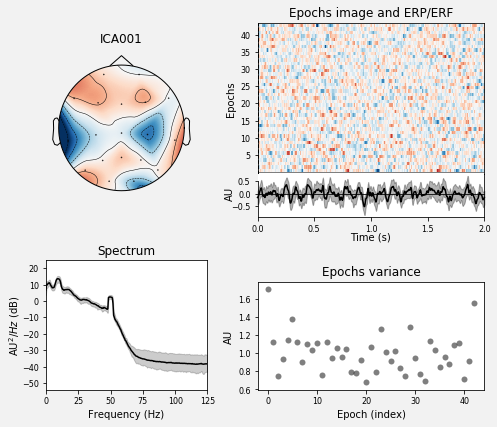

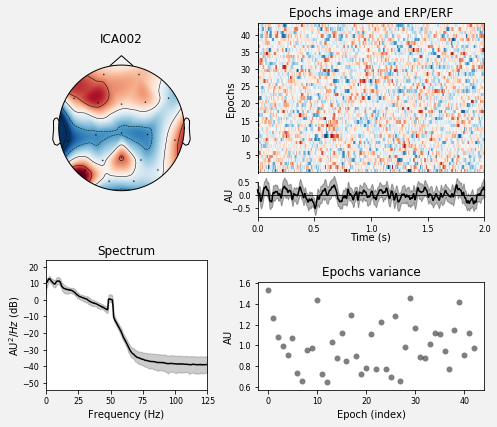

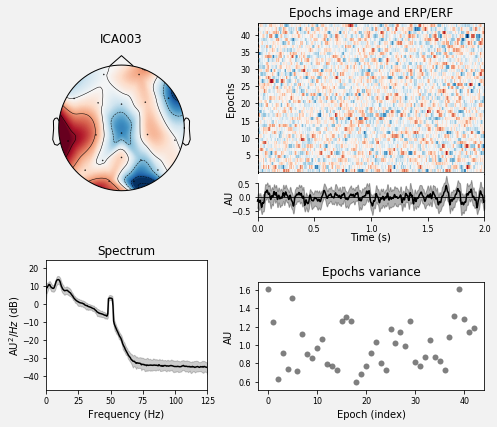

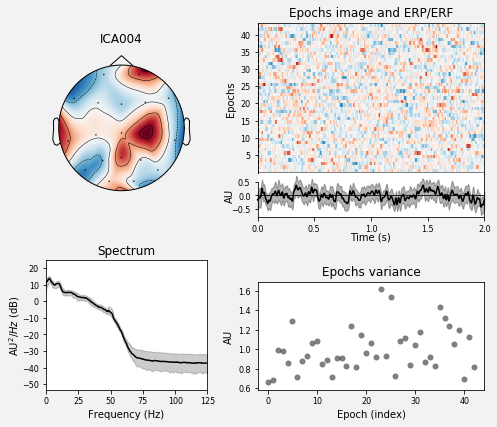

Creating RawArray with float64 data, n_channels=19, n_times=63072
    Range : 0 ... 63071 =      0.000 ...   252.284 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 1.5s.
    using multitaper spectrum estimation with 7 DPSS windows


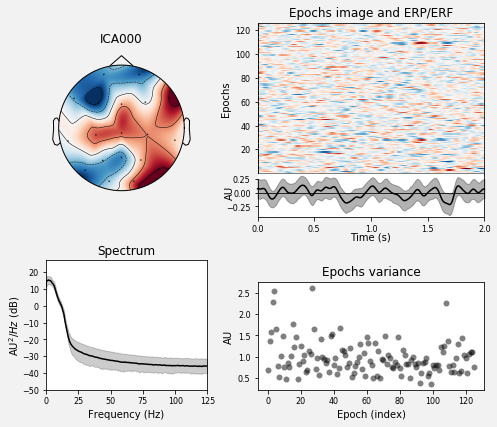

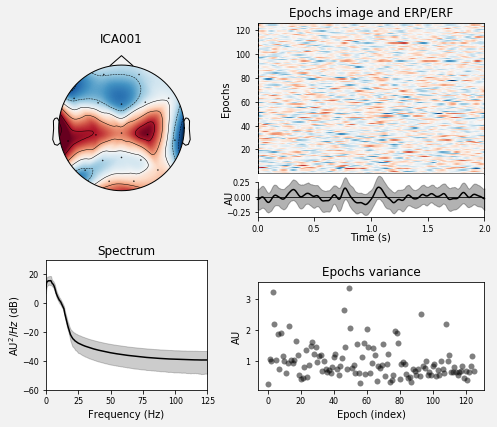

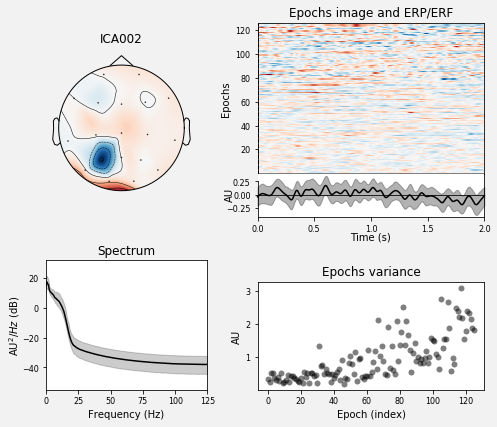

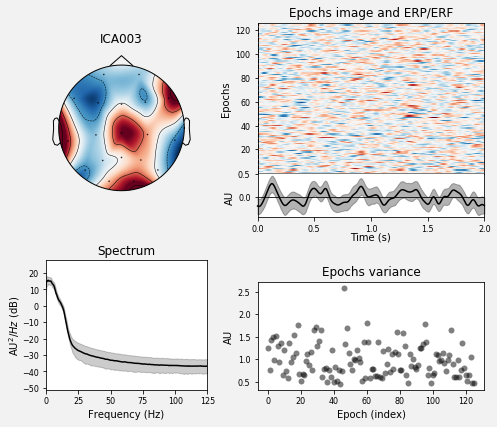

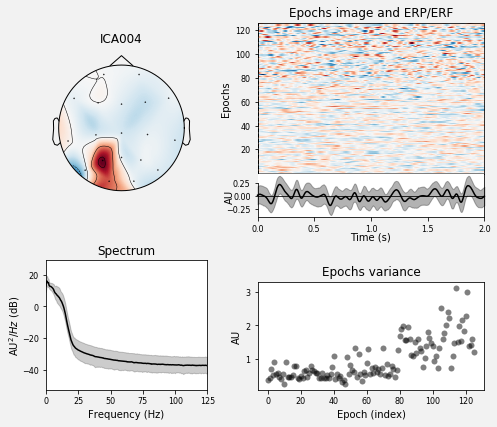

Creating RawArray with float64 data, n_channels=19, n_times=92275
    Range : 0 ... 92274 =      0.000 ...   369.096 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 1.2s.
    using multitaper spectrum estimation with 7 DPSS windows


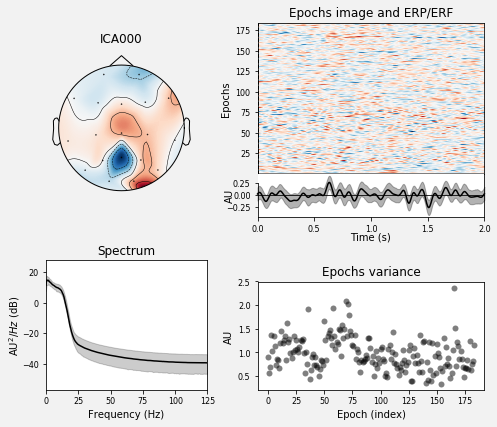

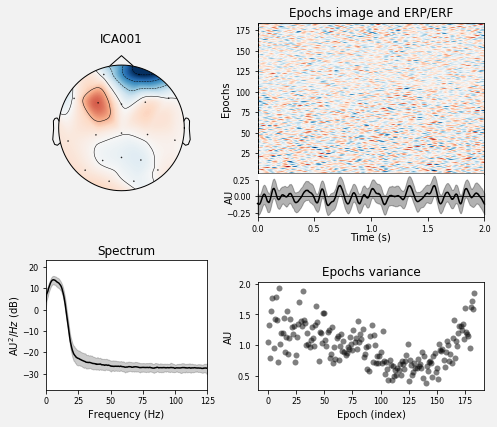

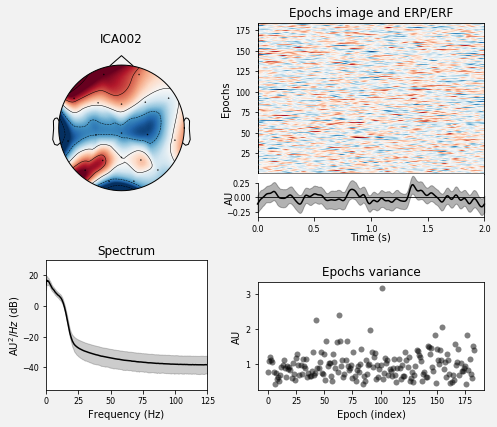

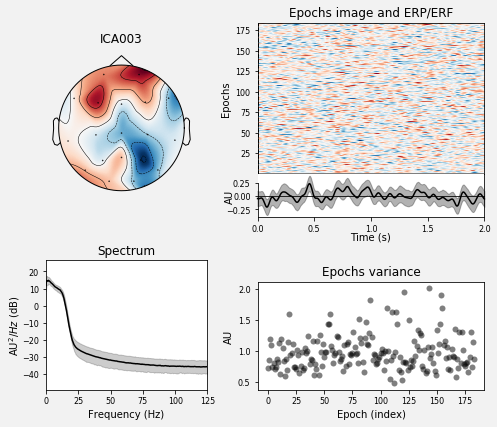

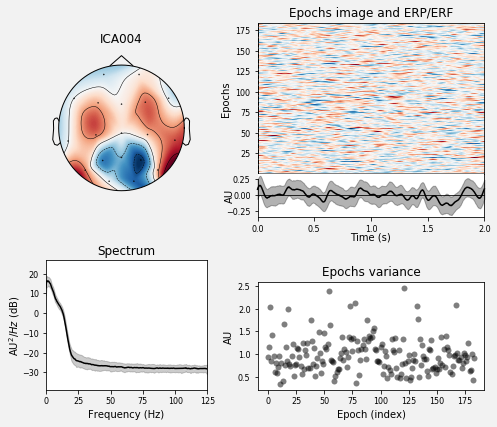

Creating RawArray with float64 data, n_channels=19, n_times=22122
    Range : 0 ... 22121 =      0.000 ...    88.484 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.9s.
    using multitaper spectrum estimation with 7 DPSS windows


/home/kovar/miniconda3/envs/thesis/lib/python3.6/site-packages/sklearn/decomposition/fastica_.py:121: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning)


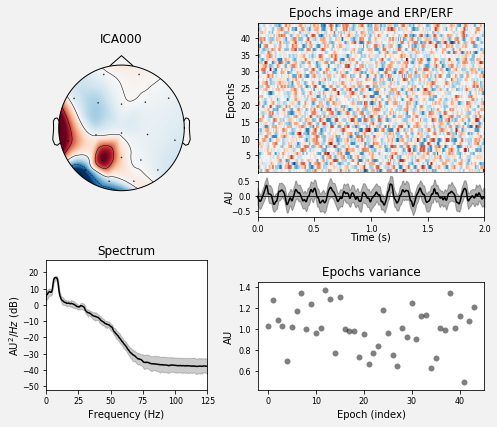

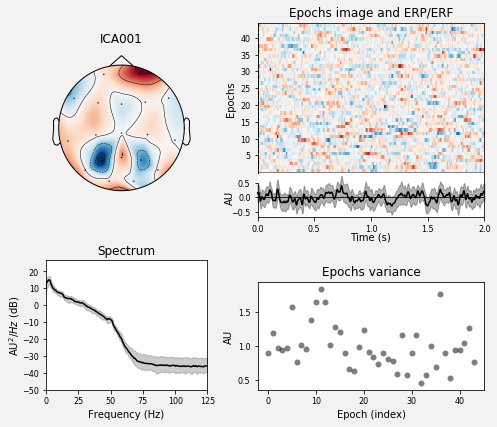

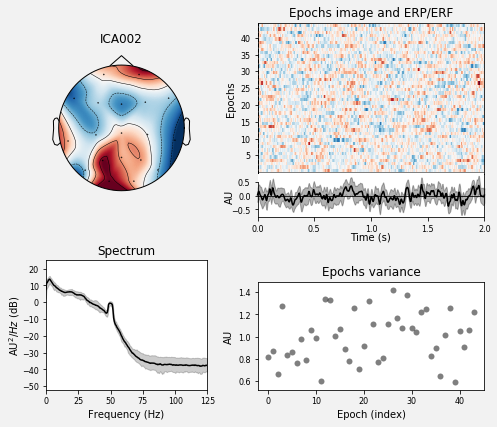

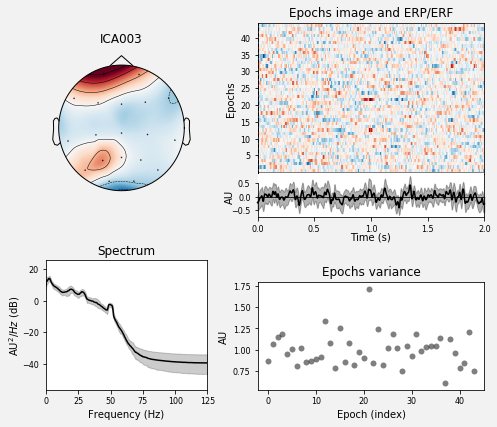

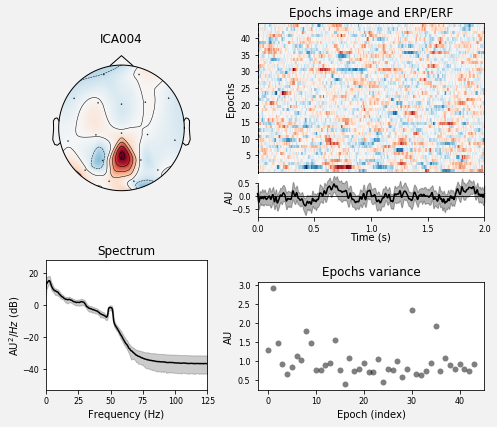

Creating RawArray with float64 data, n_channels=19, n_times=33616
    Range : 0 ... 33615 =      0.000 ...   134.460 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.4s.
    using multitaper spectrum estimation with 7 DPSS windows


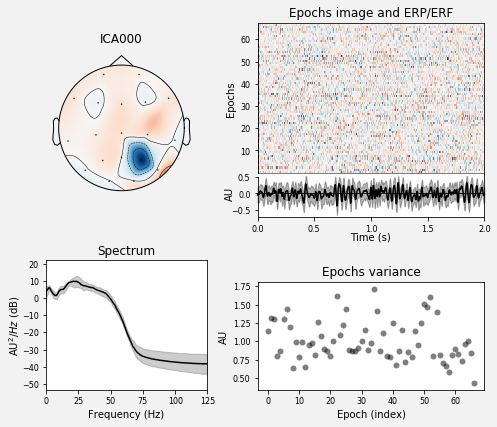

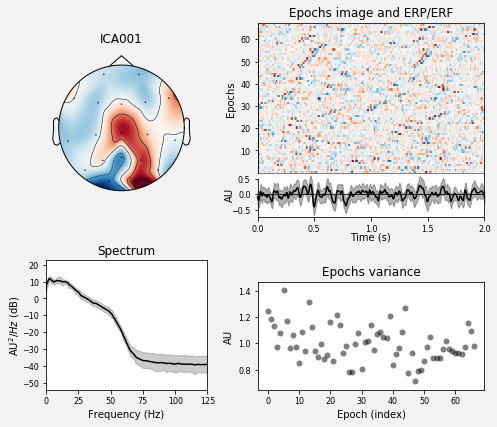

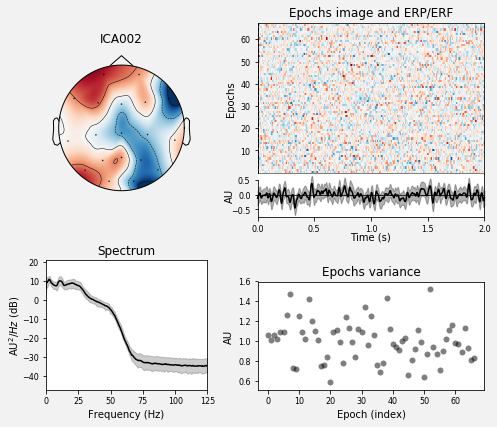

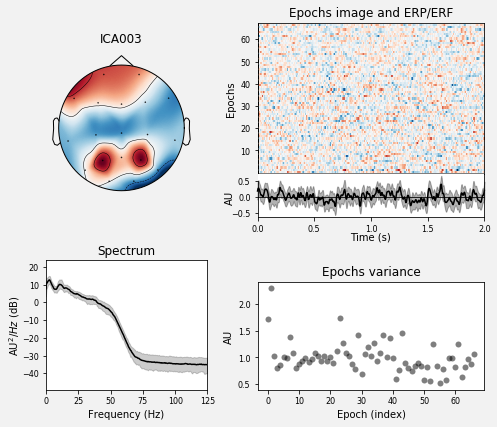

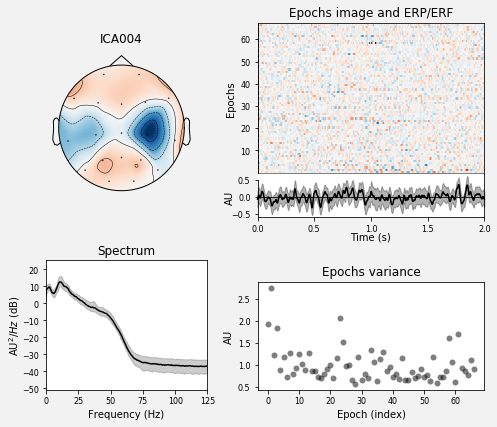

Creating RawArray with float64 data, n_channels=19, n_times=33886
    Range : 0 ... 33885 =      0.000 ...   135.540 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.4s.
    using multitaper spectrum estimation with 7 DPSS windows


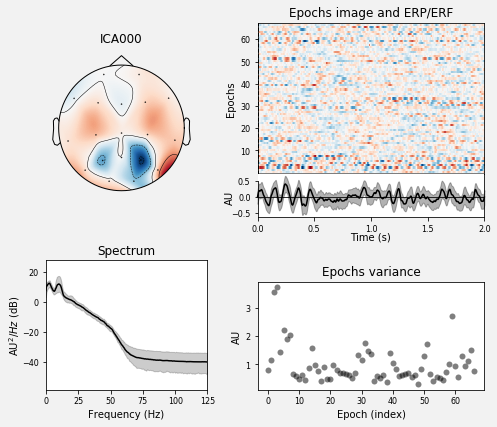

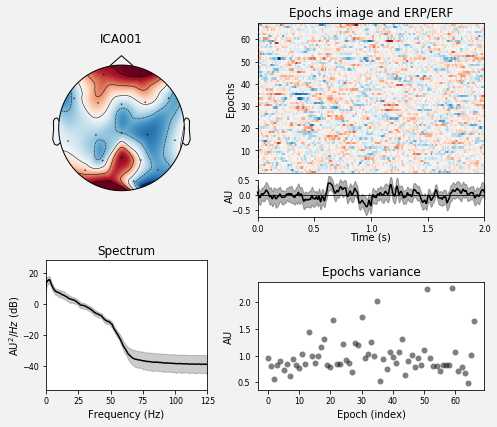

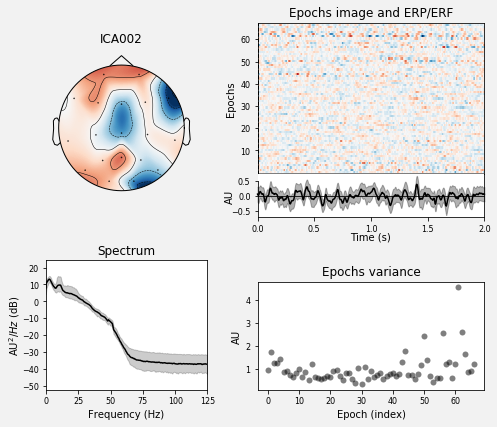

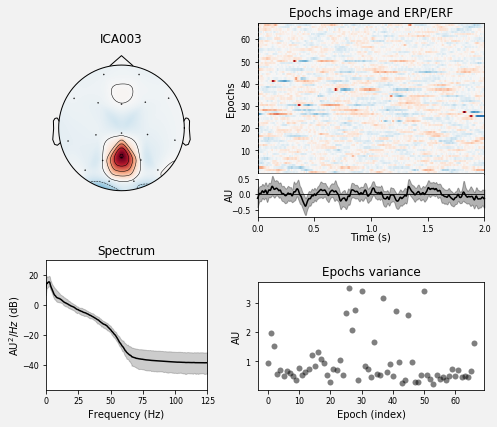

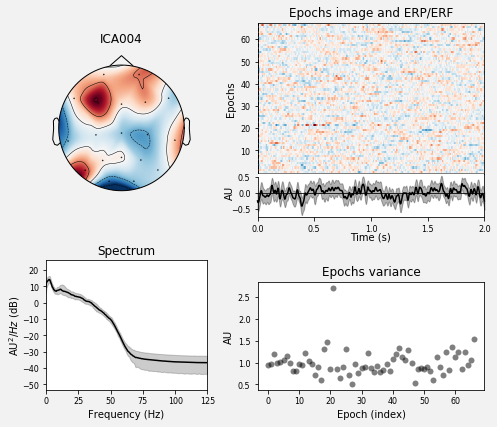

Creating RawArray with float64 data, n_channels=19, n_times=16045
    Range : 0 ... 16044 =      0.000 ...    64.176 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.6s.
    using multitaper spectrum estimation with 7 DPSS windows


/home/kovar/miniconda3/envs/thesis/lib/python3.6/site-packages/sklearn/decomposition/fastica_.py:121: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning)


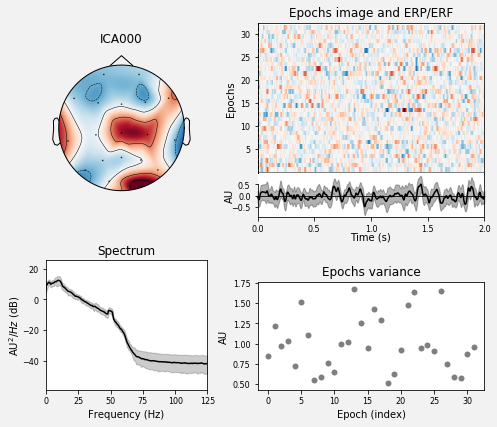

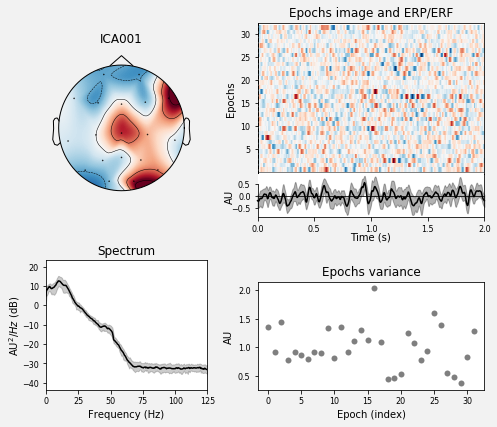

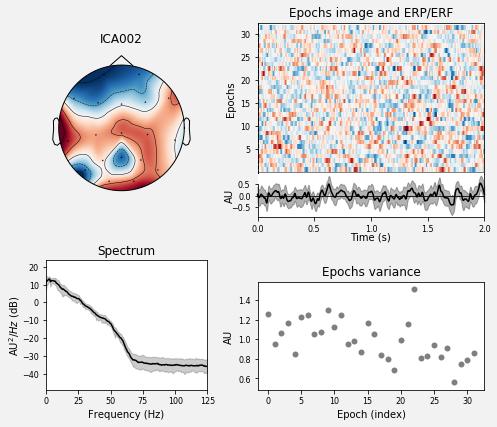

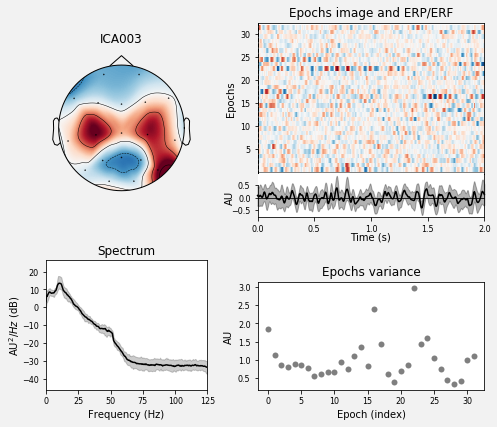

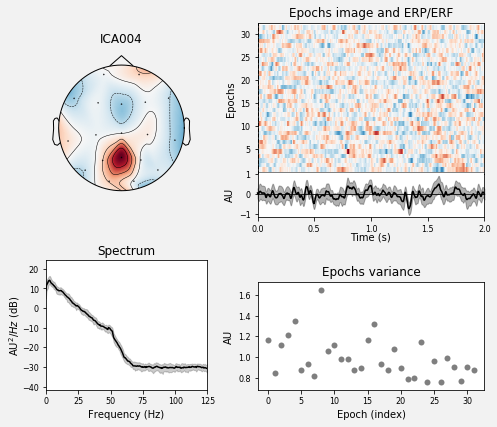

Creating RawArray with float64 data, n_channels=19, n_times=19587
    Range : 0 ... 19586 =      0.000 ...    78.344 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.3s.
    using multitaper spectrum estimation with 7 DPSS windows


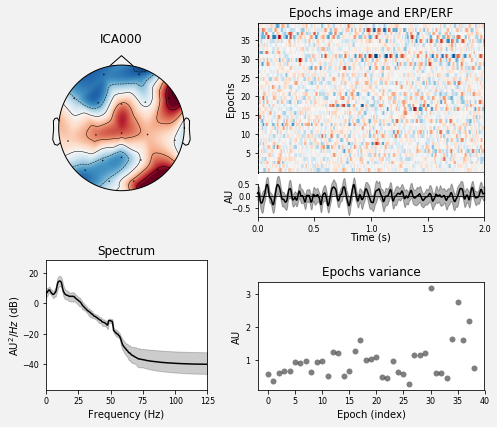

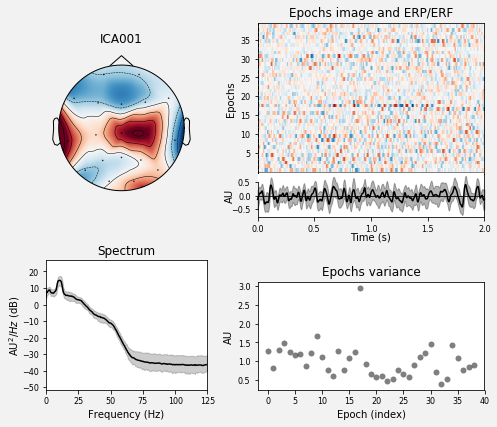

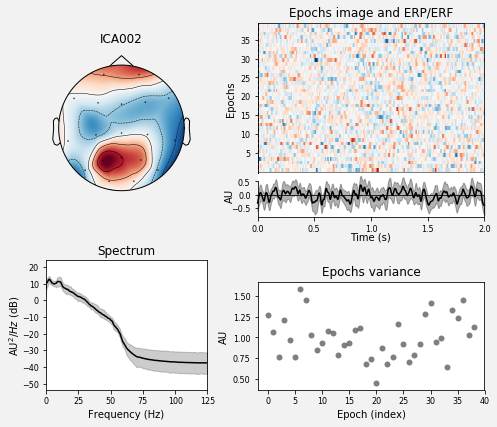

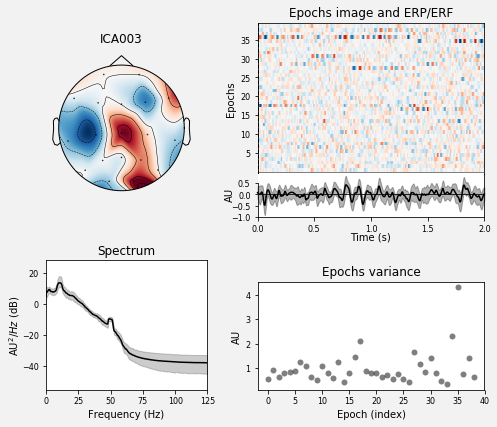

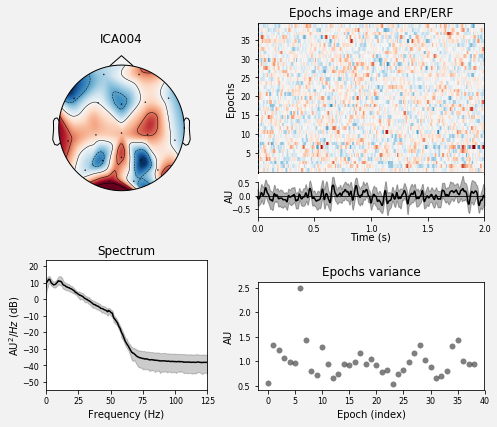

Creating RawArray with float64 data, n_channels=19, n_times=85278
    Range : 0 ... 85277 =      0.000 ...   341.108 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.7s.
    using multitaper spectrum estimation with 7 DPSS windows


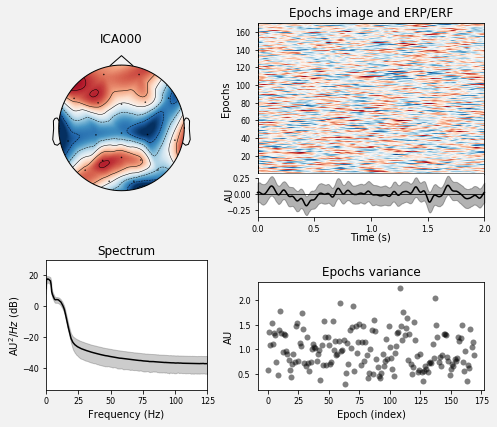

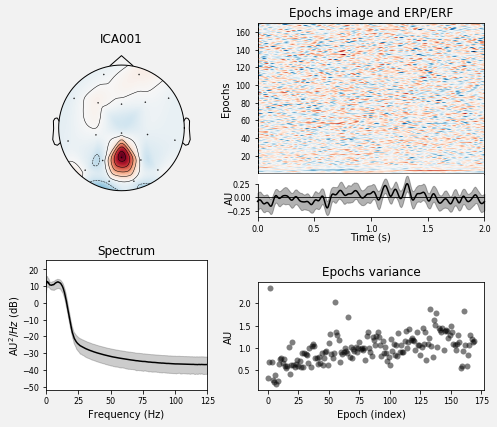

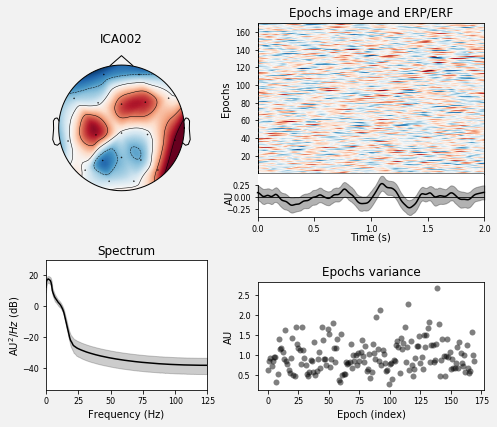

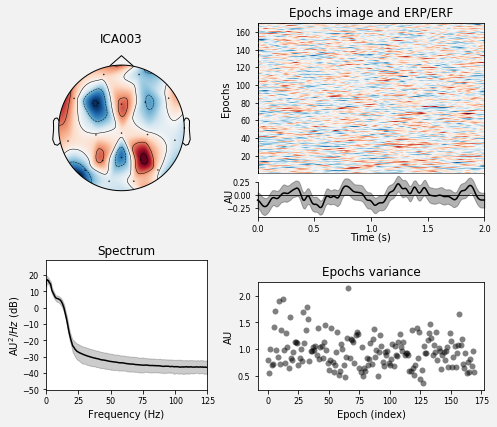

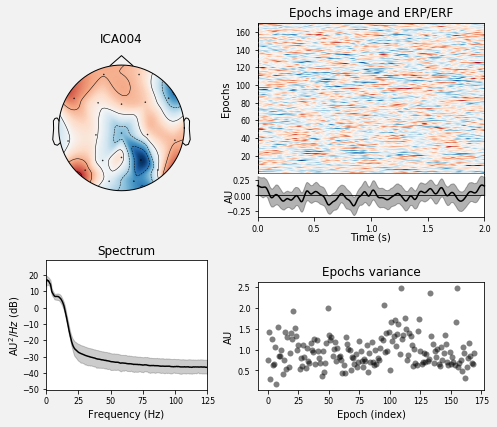

Creating RawArray with float64 data, n_channels=19, n_times=25439
    Range : 0 ... 25438 =      0.000 ...   101.752 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.5s.
    using multitaper spectrum estimation with 7 DPSS windows


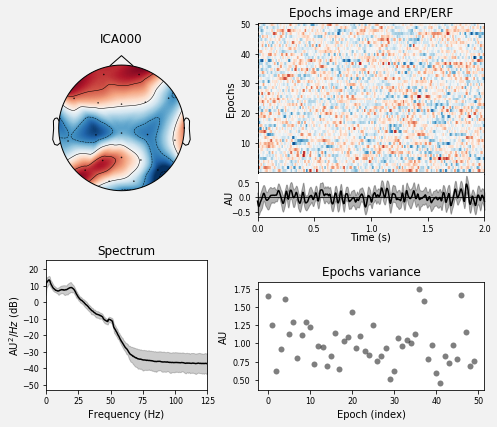

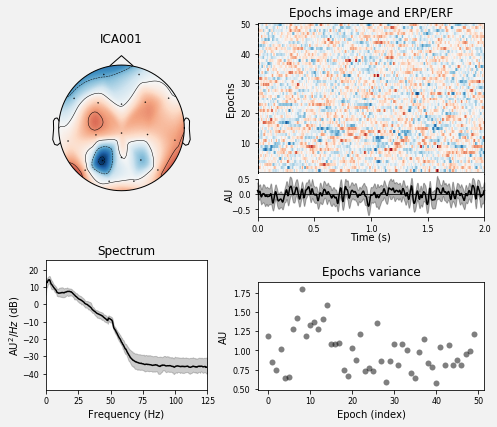

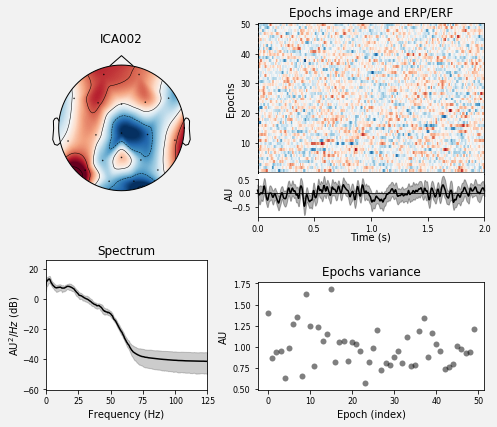

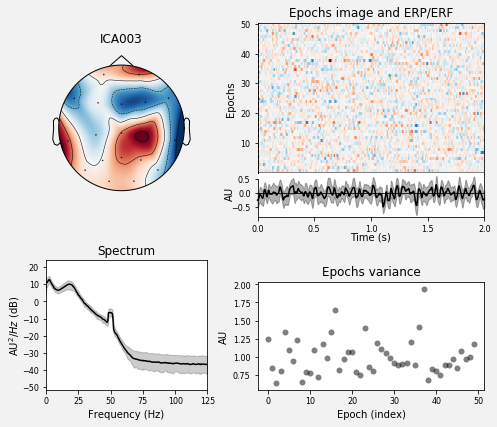

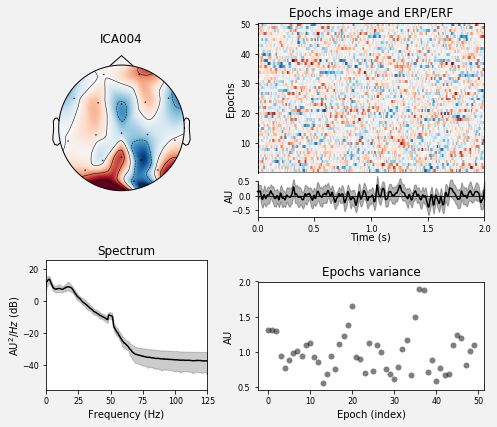

Creating RawArray with float64 data, n_channels=19, n_times=62729
    Range : 0 ... 62728 =      0.000 ...   250.912 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.6s.
    using multitaper spectrum estimation with 7 DPSS windows


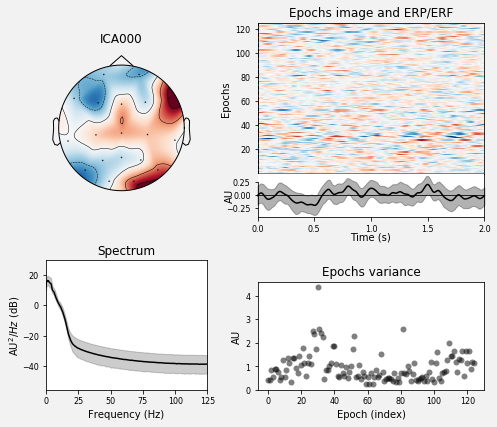

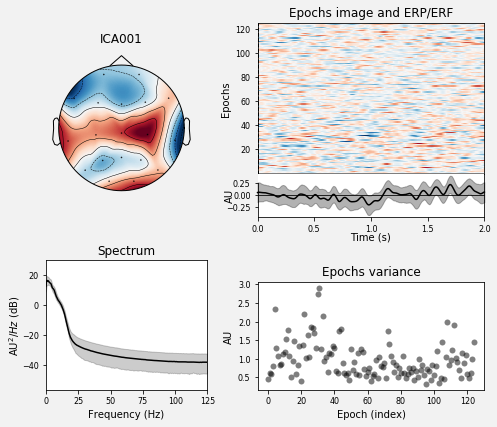

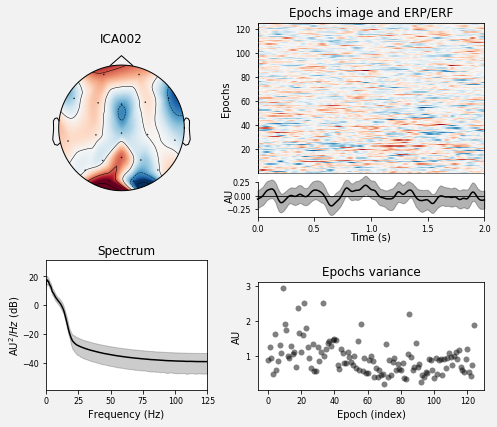

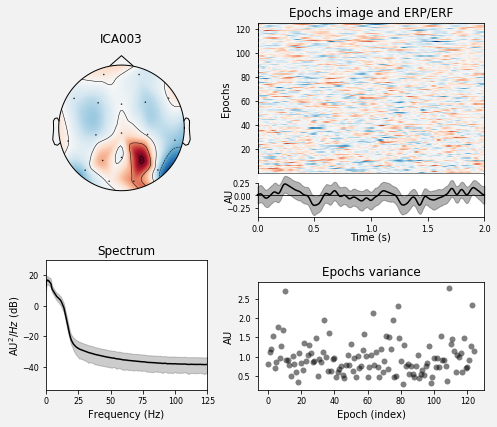

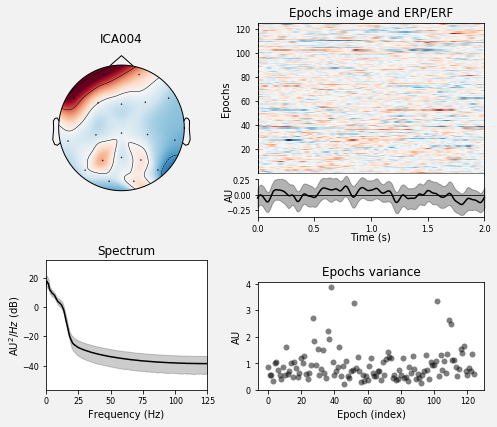

Creating RawArray with float64 data, n_channels=19, n_times=85187
    Range : 0 ... 85186 =      0.000 ...   340.744 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 1.1s.
    using multitaper spectrum estimation with 7 DPSS windows


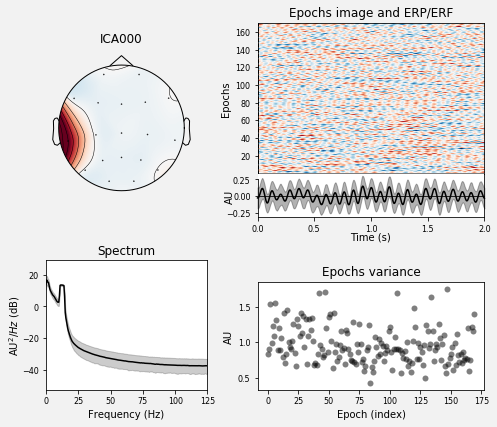

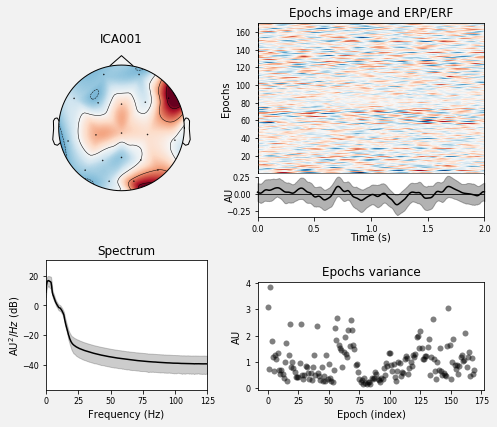

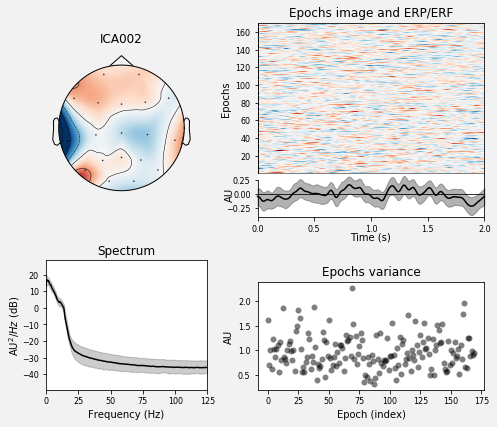

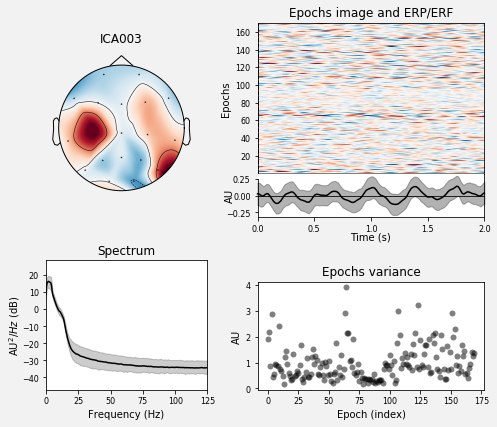

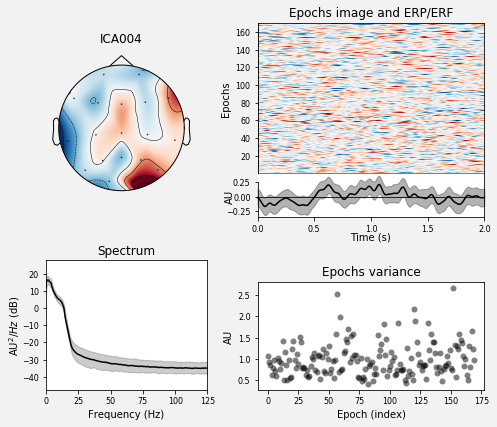

Creating RawArray with float64 data, n_channels=19, n_times=60796
    Range : 0 ... 60795 =      0.000 ...   243.180 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.5s.
    using multitaper spectrum estimation with 7 DPSS windows


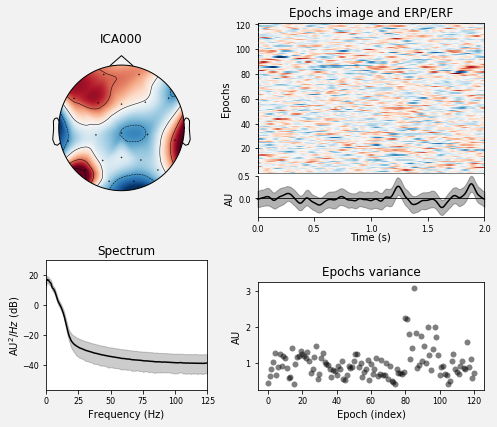

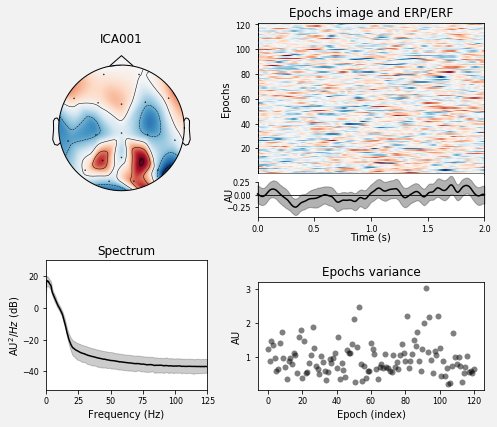

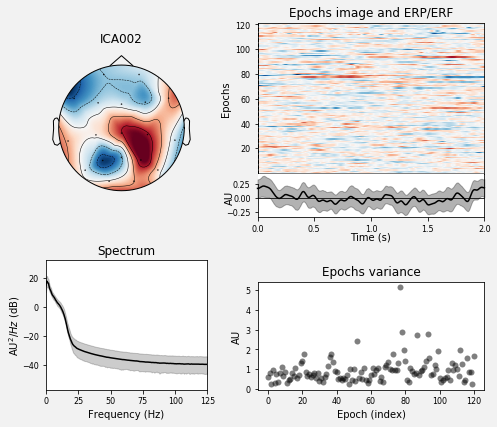

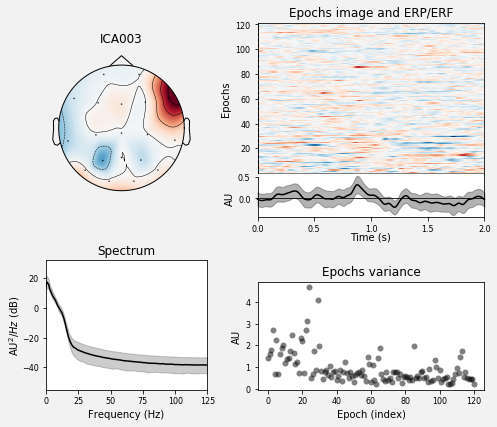

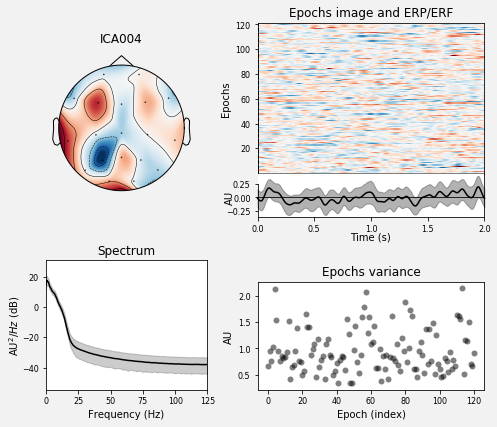

Creating RawArray with float64 data, n_channels=19, n_times=18655
    Range : 0 ... 18654 =      0.000 ...    74.616 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.7s.
    using multitaper spectrum estimation with 7 DPSS windows


/home/kovar/miniconda3/envs/thesis/lib/python3.6/site-packages/sklearn/decomposition/fastica_.py:121: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning)


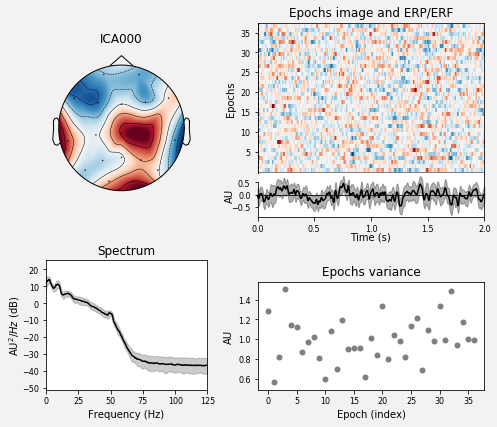

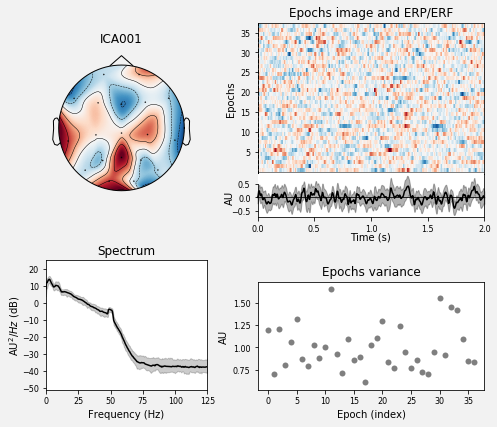

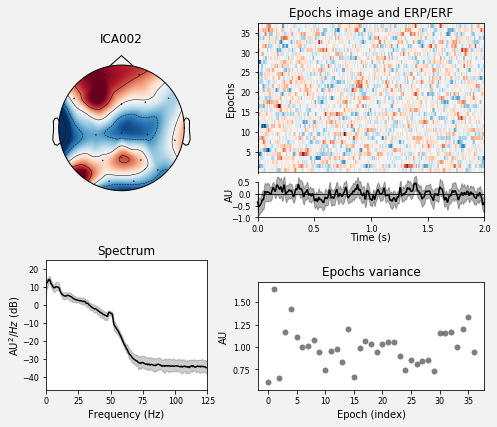

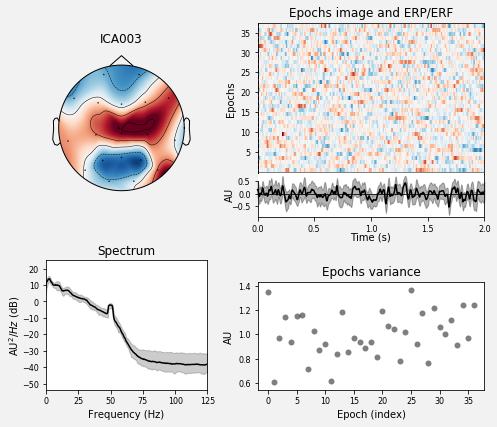

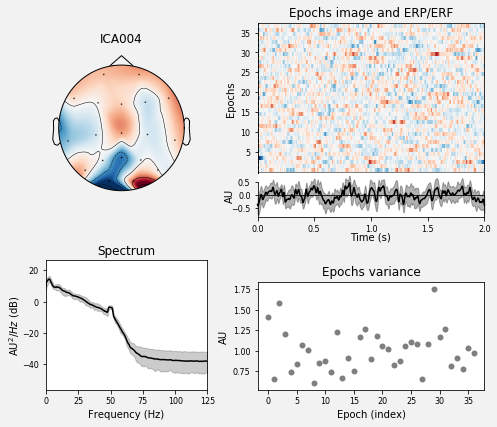

Creating RawArray with float64 data, n_channels=19, n_times=84836
    Range : 0 ... 84835 =      0.000 ...   339.340 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 1.2s.
    using multitaper spectrum estimation with 7 DPSS windows


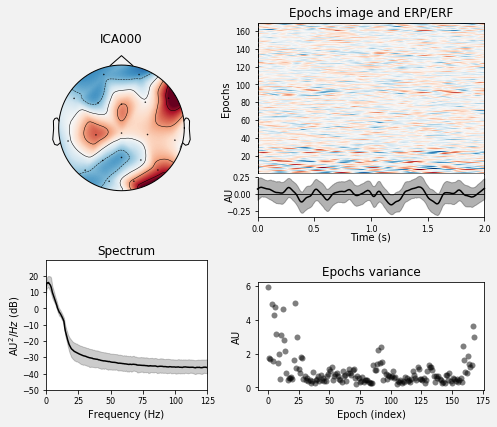

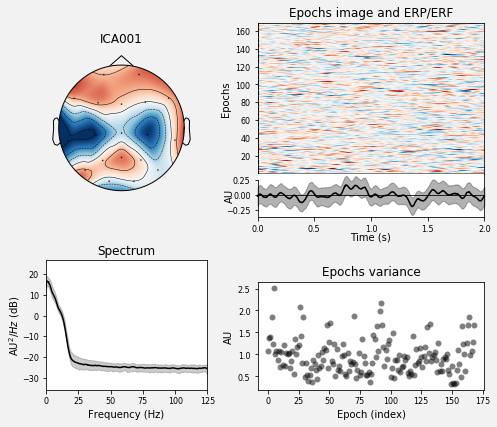

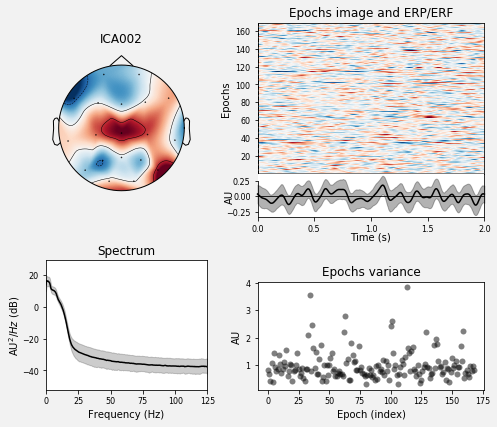

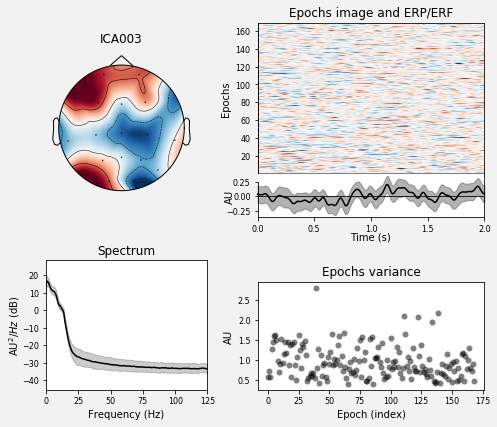

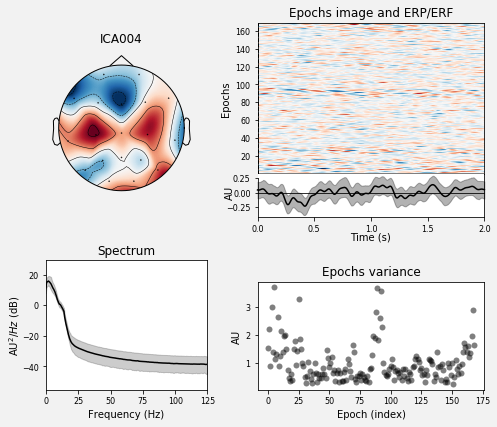

Creating RawArray with float64 data, n_channels=19, n_times=20762
    Range : 0 ... 20761 =      0.000 ...    83.044 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.8s.
    using multitaper spectrum estimation with 7 DPSS windows


/home/kovar/miniconda3/envs/thesis/lib/python3.6/site-packages/sklearn/decomposition/fastica_.py:121: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning)


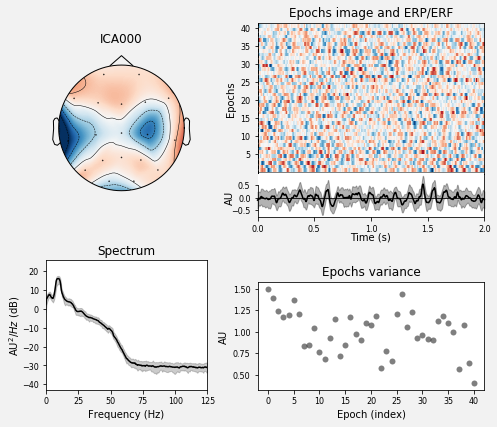

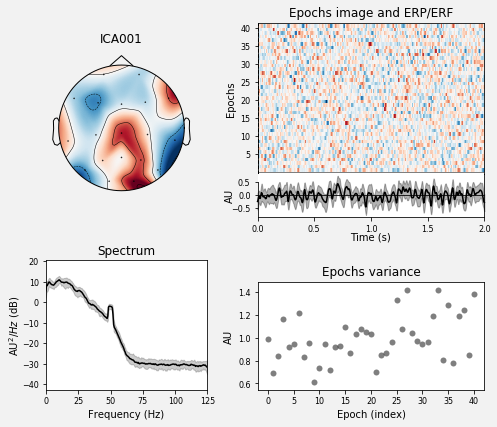

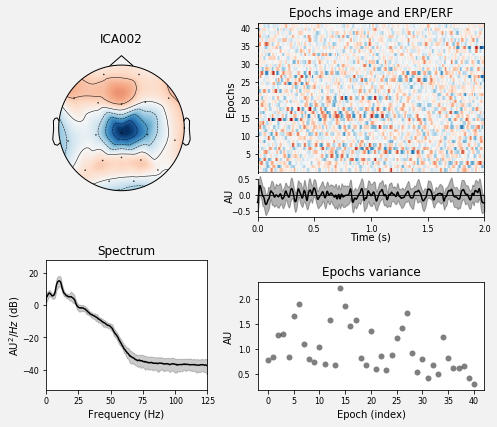

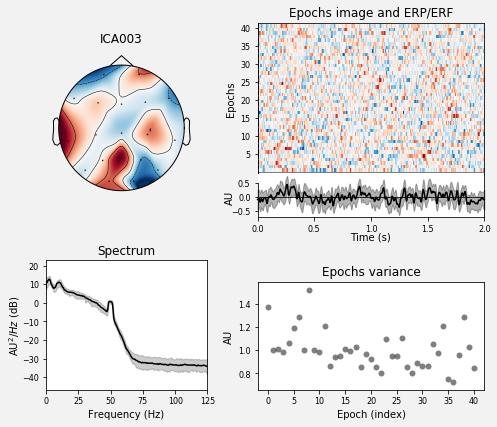

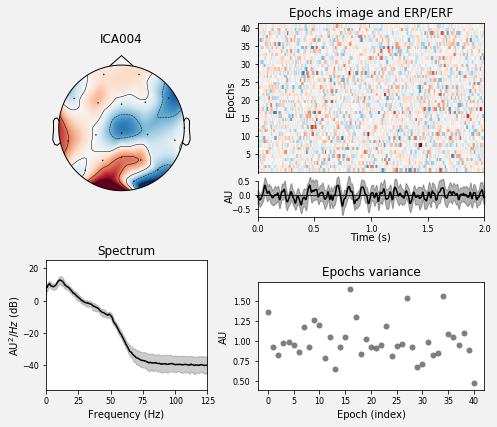

Creating RawArray with float64 data, n_channels=19, n_times=88216
    Range : 0 ... 88215 =      0.000 ...   352.860 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 0.8s.
    using multitaper spectrum estimation with 7 DPSS windows


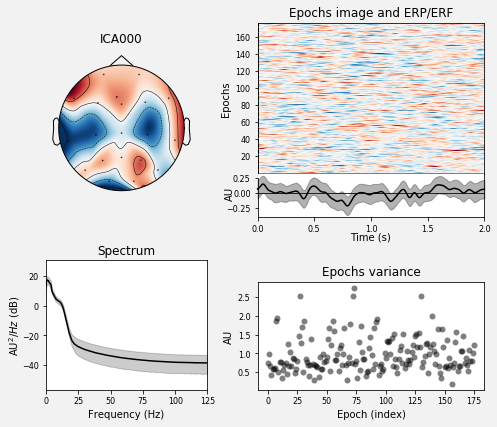

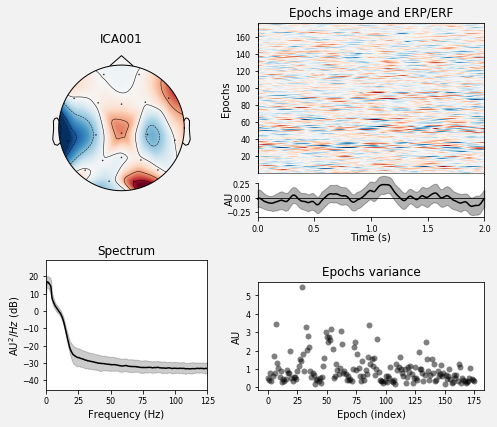

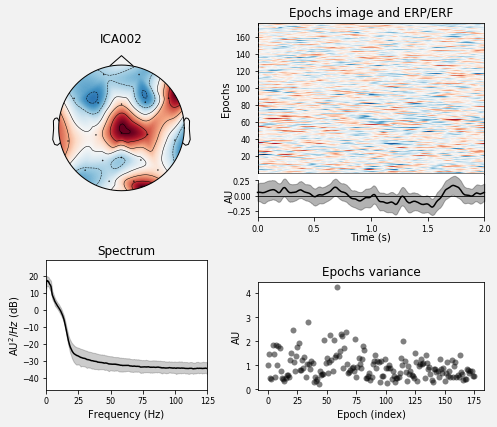

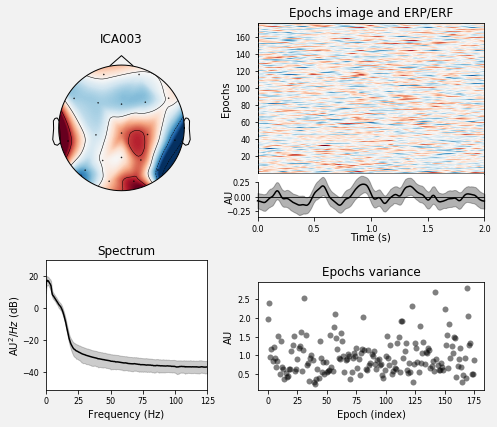

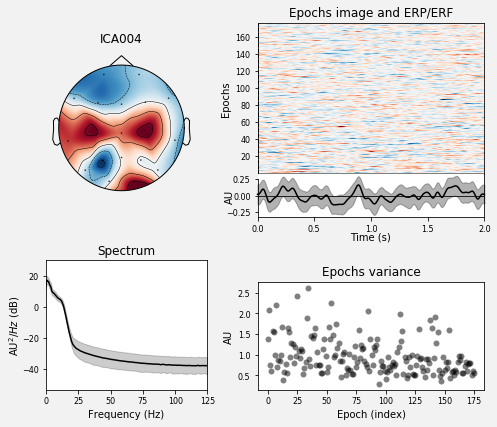

Creating RawArray with float64 data, n_channels=19, n_times=61058
    Range : 0 ... 61057 =      0.000 ...   244.228 secs
Ready.
Fitting ICA to data using 19 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Using all PCA components: 19


/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


Fitting ICA took 2.1s.
    using multitaper spectrum estimation with 7 DPSS windows


/home/kovar/miniconda3/envs/thesis/lib/python3.6/site-packages/sklearn/decomposition/fastica_.py:121: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning)


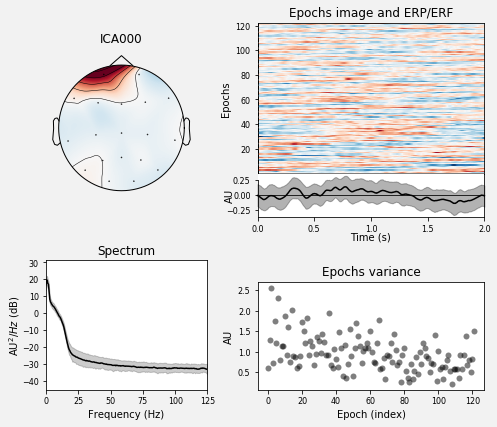

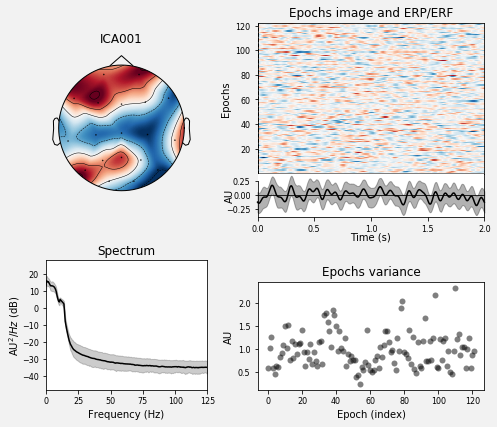

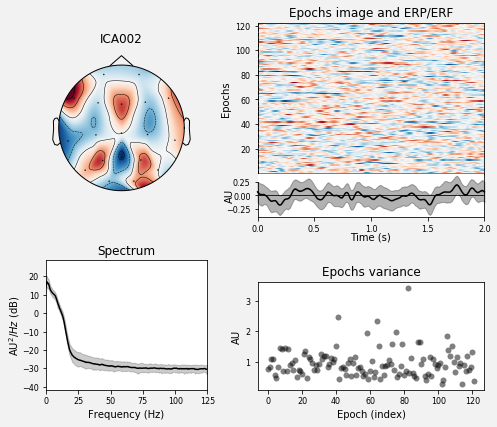

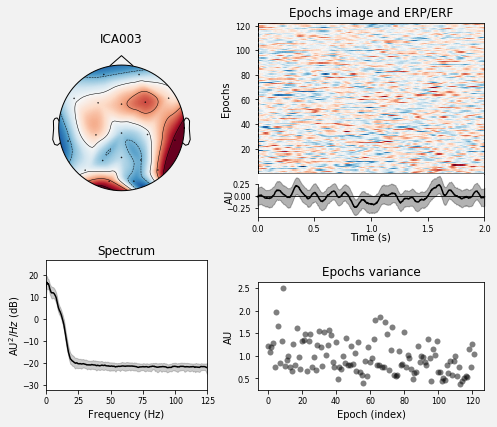

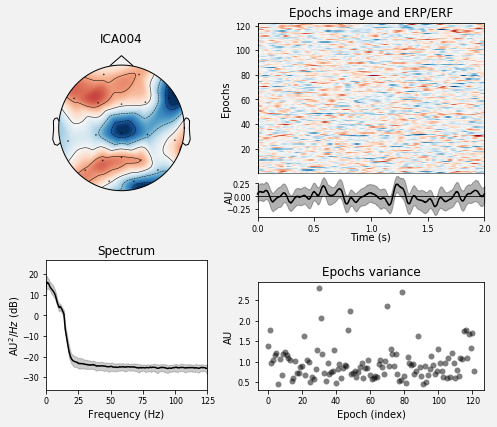

/home/kovar/thesis_project/src/data/data_files.py:22: FutureWarning: read_table is deprecated, use read_csv instead.
  file_path, sep='\t', names=CHANNEL_NAMES, skiprows=[0])


ParserError: Error tokenizing data. C error: Buffer overflow caught - possible malformed input file.


In [49]:
import numpy as np

import mne

from mne.preprocessing import ICA
from mne.preprocessing import create_eog_epochs, create_ecg_epochs
from data.data_files import df_from_tdt

# getting some data ready
# raw_fname = data_path + '/MEG/sample/sample_audvis_filt-0-40_raw.fif'
for fname in os.listdir(RAW_ROOT):
    raw_fname = os.path.join(RAW_ROOT, fname)
    raw = df_from_tdt(raw_fname)
    info = mne.create_info(mont.ch_names, 250, ch_types='eeg', montage=mont)
    raw = mne.io.RawArray(np.transpose(raw.values), info=info)

    # 1Hz high pass is often helpful for fitting ICA (already lowpassed @ 40 Hz)
    # raw.filter(1., None, n_jobs=1, fir_design='firwin')

    picks_meg = mne.pick_types(raw.info, meg=False, eeg=True, eog=False,
                           stim=False, exclude='bads')

    method = 'fastica'

    # Choose other parameters
    # n_components = 25  # if float, select n_components by explained variance of PCA
    # decim = 3  # we need sufficient statistics, not all time points -> saves time

    # we will also set state of the random number generator - ICA is a
    # non-deterministic algorithm, but we want to have the same decomposition
    # and the same order of components each time this tutorial is run
    random_state = 23

    ica = ICA(method=method, random_state=random_state)
    reject = dict(mag=5e-12, grad=4000e-13)
    ica.fit(raw, picks=picks_meg, decim=decim, reject=reject)

    ica.plot_properties(raw)